In [1]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np
from collections import deque

In [2]:
dataset_path = "nate_dataset"
imgs = []

for file_name in os.listdir(dataset_path):
    if file_name.lower().endswith(".jpg"):
        image_path = os.path.join(dataset_path, file_name)
        cur_img = cv2.imread(image_path)
        if cur_img is not None:
            imgs.append(cur_img)
        else:
            print(f"Error reading {image_path}")

In [3]:
gray_imgs = []

for cur_img in imgs:
    # Step 1: Convert to grayscale
    gray = cv2.cvtColor(cur_img, cv2.COLOR_BGR2GRAY)
    gray = cv2.resize(gray, (800, 800)) 
    gray_imgs.append(gray)


In [4]:
# Gaussian blur w 3x3 kernel
# blurred_image = cv2.GaussianBlur(gray, (3, 3), 0)

In [5]:
def gaussian_kernel(size, sigma):
    """ Implementation of Gaussian Kernel.

    This function follows the gaussian kernel formula,
    and creates a kernel matrix.

    Hints:
    - Use np.pi and np.exp to compute pi and exp.

    Args:
        size: int of the size of output matrix.
        sigma: float of sigma to calculate kernel.

    Returns:
        kernel: numpy array of shape (size, size).
    """

    kernel = np.zeros((size, size))

    ### YOUR CODE HERE
    for i in range(size):
      for j in range(size):
        k = (size - 1) // 2
        base = 1 / ((2 * np.pi * (sigma ** 2)))
        exp = ((((i - k) ** 2) + ((j - k) ** 2)) / (2 * (sigma ** 2)))

        kernel[i][j] = (base * (np.exp(-exp)))
    ### END YOUR CODE
    return kernel

In [6]:
def conv(image, kernel):
    """ An implementation of convolution filter.

    This function uses element-wise multiplication and np.sum()
    to efficiently compute weighted sum of neighborhood at each
    pixel.

    Args:
        image: numpy array of shape (Hi, Wi).
        kernel: numpy array of shape (Hk, Wk).

    Returns:
        out: numpy array of shape (Hi, Wi).
    """
    Hi, Wi = image.shape
    Hk, Wk = kernel.shape
    out = np.zeros((Hi, Wi))

    # For this assignment, we will use edge values to pad the images.
    # Zero padding will make derivatives at the image boundary very big,
    # whereas we want to ignore the edges at the boundary.
    pad_width0 = Hk // 2
    pad_width1 = Wk // 2
    pad_width = ((pad_width0,pad_width0),(pad_width1,pad_width1))
    padded = np.pad(image, pad_width, mode='edge')

    ### YOUR CODE HERE
    flipped_kernel = np.flip(kernel)
    for i in range(Hi):
      for j in range(Wi):
        height_bound = i + Hk
        width_bound = j + Wk

        cur_area = padded[i:height_bound, j:width_bound]
        out[i][j] = np.sum(cur_area * flipped_kernel)
    ### END YOUR CODE

    return out

In [7]:
def partial_x(img):
    """ Computes partial x-derivative of input img.

    Hints:
        - You may use the conv function in defined in this file.

    Args:
        img: numpy array of shape (H, W).
    Returns:
        out: x-derivative image.
    """

    out = None

    ### YOUR CODE HERE
    kernel = np.array([[-0.5, 0, 0.5]])
    flipped_kernel = np.flip(kernel)
    out = conv(img, flipped_kernel)
    ### END YOUR CODE

    return out

In [8]:

def partial_y(img):
    """ Computes partial y-derivative of input img.

    Hints:
        - You may use the conv function in defined in this file.

    Args:
        img: numpy array of shape (H, W).
    Returns:
        out: y-derivative image.
    """

    out = None

    ## YOUR CODE HERE
    kernel = np.array([[-0.5], [0], [0.5]])
    flipped_kernel = np.flip(kernel)
    out = conv(img, flipped_kernel)
    ### END YOUR CODE

    return out

In [9]:

def gradient(img):
    """ Returns gradient magnitude and direction of input img.

    Args:
        img: Grayscale image. Numpy array of shape (H, W).

    Returns:
        G: Magnitude of gradient at each pixel in img.
            Numpy array of shape (H, W).
        theta: Direction(in degrees, 0 <= theta < 360) of gradient
            at each pixel in img. Numpy array of shape (H, W).

    Hints:
        - Use np.sqrt and np.arctan2 to calculate square root and arctan
    """
    G = np.zeros(img.shape)
    theta = np.zeros(img.shape)

    ### YOUR CODE HERE
    Gx = partial_x(img)
    Gy = partial_y(img)

    G = np.sqrt(((Gx ** 2) + (Gy ** 2)))
    theta = (np.arctan2(Gy, Gx) * (180 / np.pi))
    theta %= 360
    ### END YOUR CODE

    return G, theta

In [10]:
def non_maximum_suppression(G, theta):
    """ Performs non-maximum suppression.

    This function performs non-maximum suppression along the direction
    of gradient (theta) on the gradient magnitude image (G).

    Args:
        G: gradient magnitude image with shape of (H, W).
        theta: direction of gradients with shape of (H, W).

    Returns:
        out: non-maxima suppressed image.
    """
    H, W = G.shape
    out = np.zeros((H, W))

    # Round the gradient direction to the nearest 45 degrees
    theta = np.floor((theta + 22.5) / 45) * 45

    #print(G)
    ### BEGIN YOUR CODE
    theta %= 180
    G_padded = np.pad(G, pad_width=1, mode='constant', constant_values=0)

    for i in range(H):
      for j in range(W):
        i_pad, j_pad = i + 1, j + 1

        if theta[i][j] == 0:
          j_e = j_pad + 1
          j_w = j_pad - 1

          e_val = G_padded[i_pad][j_e]
          w_val = G_padded[i_pad][j_w]

          if e_val > G[i][j] or w_val > G[i][j]:
            out[i][j] = 0
          else:
            out[i][j] = G[i][j]

        elif theta[i][j] == 135:
          i_ne = i_pad - 1
          j_ne = j_pad + 1

          i_sw = i_pad + 1
          j_sw = j_pad - 1

          ne_val = G_padded[i_ne][j_ne]
          sw_val = G_padded[i_sw][j_sw]

          if ne_val > G[i][j] or sw_val > G[i][j]:
             out[i][j] = 0
          else:
            out[i][j] = G[i][j]

        elif theta[i][j] == 90:
          i_n = i_pad - 1
          i_s = i_pad + 1

          n_val = G_padded[i_n][j_pad]
          s_val = G_padded[i_s][j_pad]

          if n_val > G[i][j] or s_val > G[i][j]:
             out[i][j] = 0
          else:
            out[i][j] = G[i][j]

        elif theta[i][j] == 45:
          i_nw = i_pad - 1
          j_nw = j_pad - 1

          i_se = i_pad + 1
          j_se = j_pad + 1

          nw_val = G_padded[i_nw][j_nw]
          se_val = G_padded[i_se][j_se]

          if nw_val > G[i][j] or se_val > G[i][j]:
             out[i][j] = 0
          else:
            out[i][j] = G[i][j]

    ### END YOUR CODE

    return out

In [11]:
def double_thresholding(img, high, low):
  """
  Args:
      img: numpy array of shape (H, W) representing NMS edge response.
      high: high threshold(float) for strong edges.
      low: low threshold(float) for weak edges.

  Returns:
      strong_edges: Boolean array representing strong edges.
          Strong edeges are the pixels with the values greater than
          the higher threshold.
      weak_edges: Boolean array representing weak edges.
          Weak edges are the pixels with the values smaller or equal to the
          higher threshold and greater than the lower threshold.
  """

  strong_edges = np.zeros(img.shape, dtype=bool)
  weak_edges = np.zeros(img.shape, dtype=bool)

  ### YOUR CODE HERE
  H, W = np.shape(img)

  for i in range(H):
    for j in range(W):
      if img[i, j] > high:
        strong_edges[i, j] = True
      elif img[i, j] < low:
        weak_edges[i, j] = True
      else:
        strong_edges[i, j] = False
        weak_edges[i, j] = False

  ### END YOUR CODE

  return strong_edges, weak_edges

In [12]:
def get_neighbors(y, x, H, W):
    """ Return indices of valid neighbors of (y, x).

    Return indices of all the valid neighbors of (y, x) in an array of
    shape (H, W). An index (i, j) of a valid neighbor should satisfy
    the following:
        1. i >= 0 and i < H
        2. j >= 0 and j < W
        3. (i, j) != (y, x)

    Args:
        y, x: location of the pixel.
        H, W: size of the image.
    Returns:
        neighbors: list of indices of neighboring pixels [(i, j)].
    """
    neighbors = []

    for i in (y-1, y, y+1):
        for j in (x-1, x, x+1):
            if i >= 0 and i < H and j >= 0 and j < W:
                if (i == y and j == x):
                    continue
                neighbors.append((i, j))

    return neighbors

In [13]:
def link_edges(strong_edges, weak_edges):
    """ Find weak edges connected to strong edges and link them.

    Iterate over each pixel in strong_edges and perform breadth first
    search across the connected pixels in weak_edges to link them.
    Here we consider a pixel (a, b) is connected to a pixel (c, d)
    if (a, b) is one of the eight neighboring pixels of (c, d).

    Args:
        strong_edges: binary image of shape (H, W).
        weak_edges: binary image of shape (H, W).

    Returns:
        edges: numpy boolean array of shape(H, W).
    """

    H, W = strong_edges.shape
    indices = np.stack(np.nonzero(strong_edges)).T
    edges = np.zeros((H, W), dtype=bool)

    # Make new instances of arguments to leave the original
    # references intact
    weak_edges = np.copy(weak_edges)
    edges = np.copy(strong_edges)

    ### YOUR CODE HERE
    queue = deque([])
    visit = set()

    for x, y in indices:
      queue.append((x, y))
      visit.add((x, y))

    while queue:
      x, y = queue.popleft()
      neighbors = get_neighbors(x, y, H, W)

      for i, j in neighbors:
        if not weak_edges[i, j] and (i, j) not in visit:
          queue.append((i, j))
          edges[i, j] = True
          visit.add((i, j))


    ### END YOUR CODE
    return edges

In [14]:
def canny(img, kernel_size=5, sigma=1.4, high=25, low=20):
    """ Implement canny edge detector by calling functions above.

    Args:
        img: binary image of shape (H, W).
        kernel_size: int of size for kernel matrix.
        sigma: float for calculating kernel.
        high: high threshold for strong edges.
        low: low threashold for weak edges.
    Returns:
        edge: numpy array of shape(H, W).
    """
    ### YOUR CODE HERE
    kernel = gaussian_kernel(kernel_size, sigma)

    filter = conv(img, kernel)

    G, theta = gradient(filter)
    nms_image = non_maximum_suppression(G, theta)

    strong_edges, weak_edges = double_thresholding(nms_image, high, low)

    edge = link_edges(strong_edges, weak_edges)
    ### END YOUR CODE

    return edge

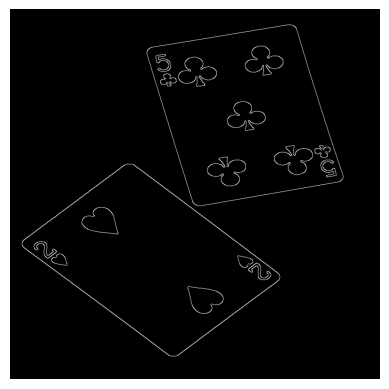

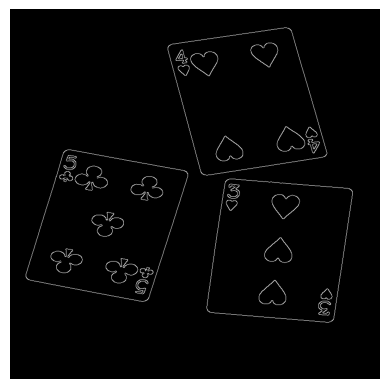

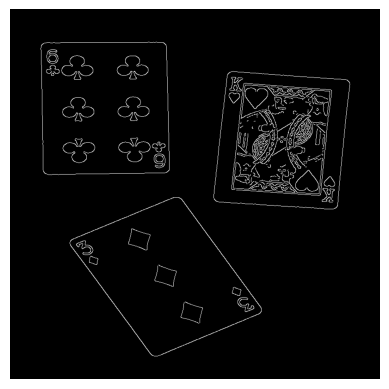

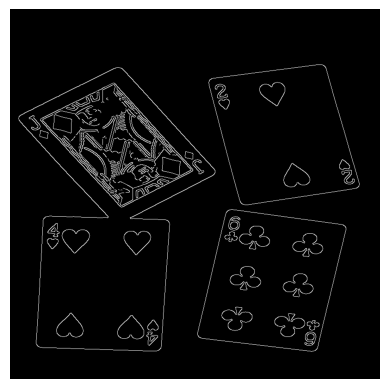

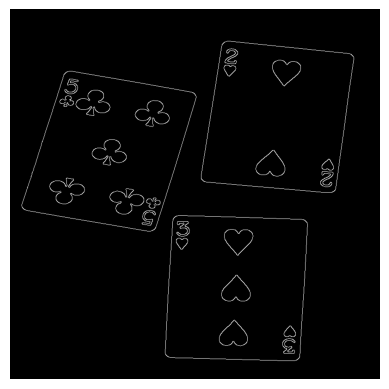

...

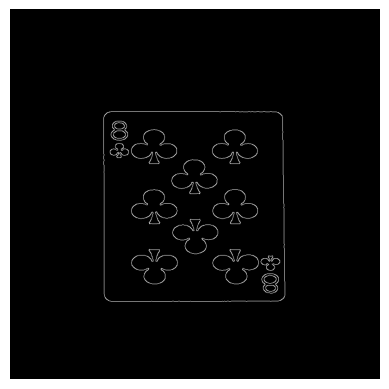

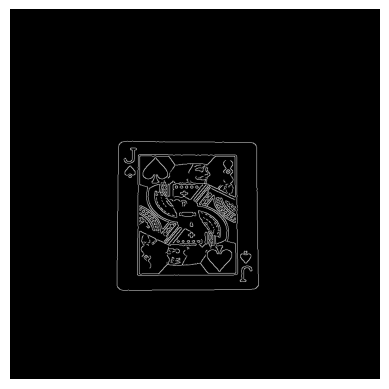

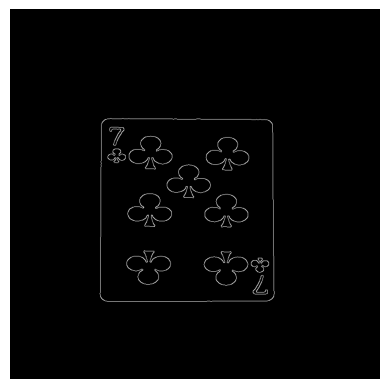

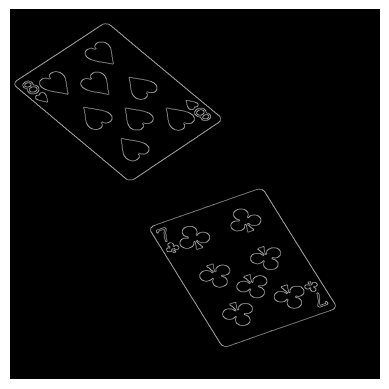

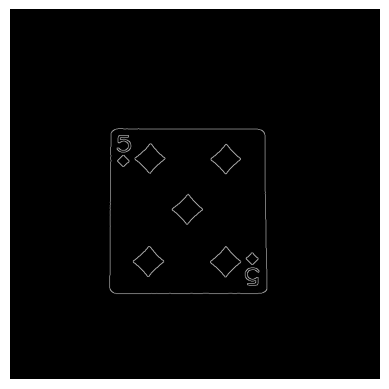

In [15]:
canny_results = []

for gray in gray_imgs:
    canny_result = canny(gray)
    canny_results.append(canny_result)
    plt.imshow(canny_result, cmap='gray')
    plt.axis('off')  
    plt.show()

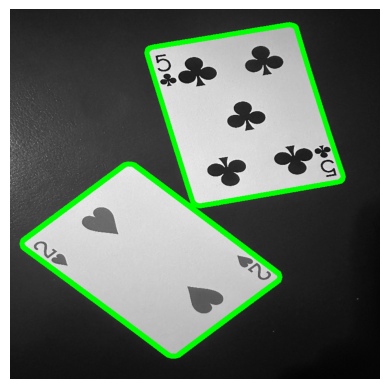

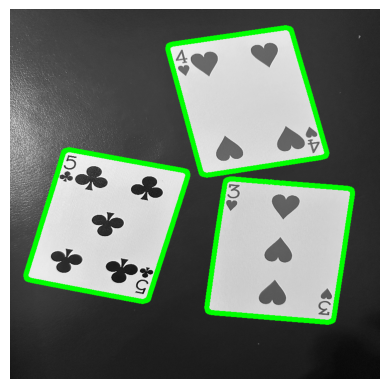

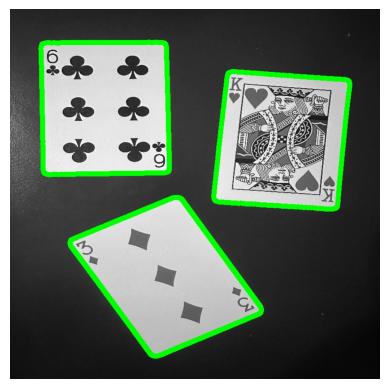

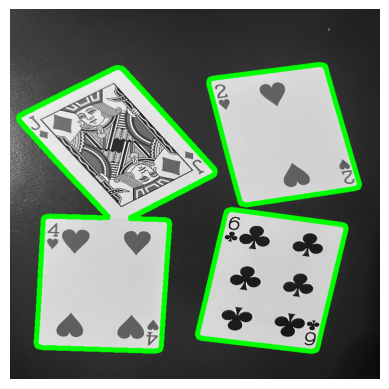

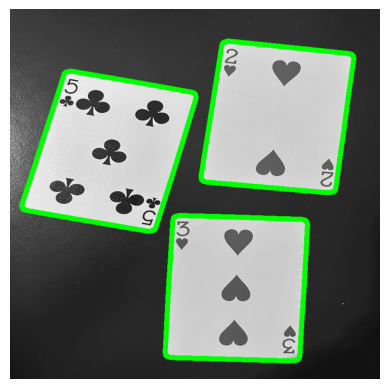

...

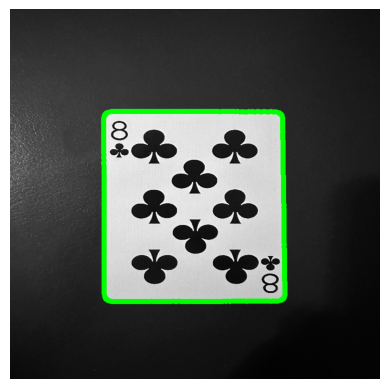

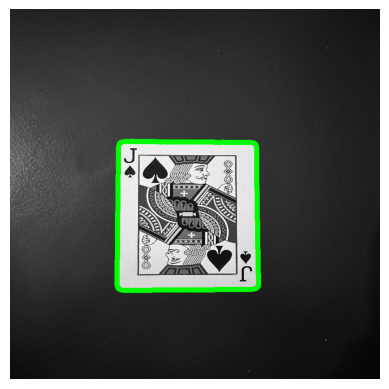

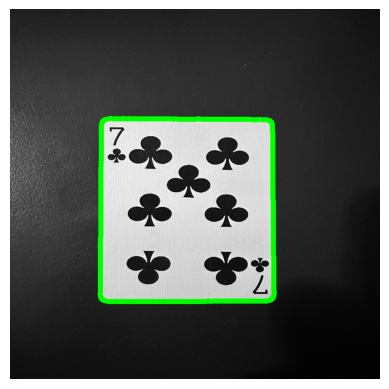

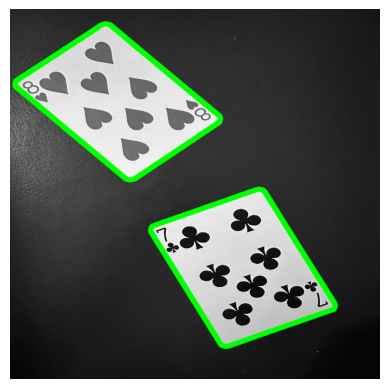

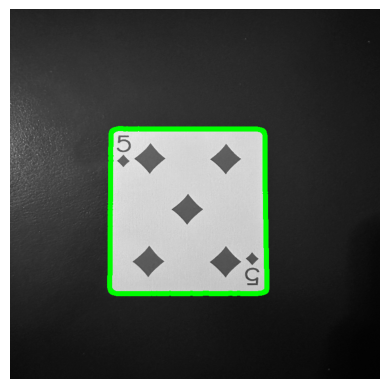

In [16]:
for gray, canny_result in zip(gray_imgs, canny_results):
    canny_result_uint8 = (canny_result * 255).astype(np.uint8)
    contours, hierarchy = cv2.findContours(canny_result_uint8, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    filtered_contours = []
    for contour in contours:
        area = cv2.contourArea(contour)
        # Adjust this threshold based on your image size
        if 10000 < area < 300000:  
            filtered_contours.append(contour)

    # Convert the corresponding grayscale image to a color image
    result = cv2.cvtColor(gray.copy(), cv2.COLOR_GRAY2BGR)

    # Draw green contours (in BGR, it's (0,255,0))
    cv2.drawContours(result, filtered_contours, -1, (0, 255, 0), 10)

    # Show the result
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()


Image 1: Contours after area filtering: 2
Image 1: Final contours: 2


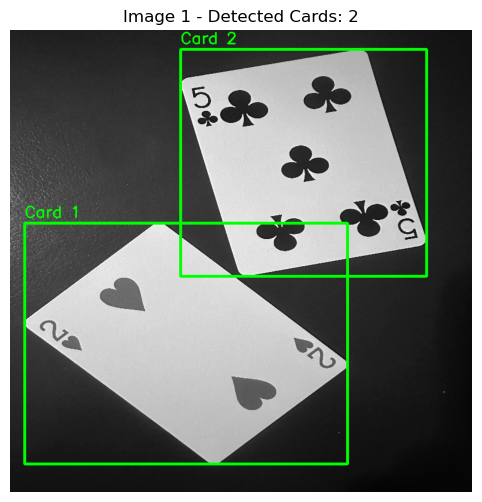

Saved output_cards/nate_image1_card_1.jpg
Saved output_cards/nate_image1_card_2.jpg


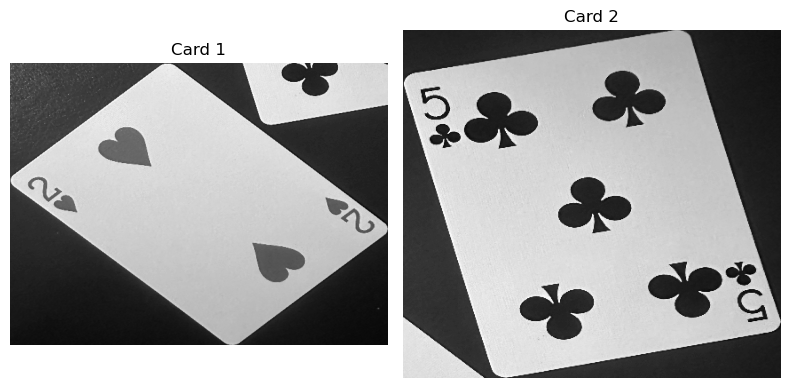

Image 2: Contours after area filtering: 3
Image 2: Final contours: 3


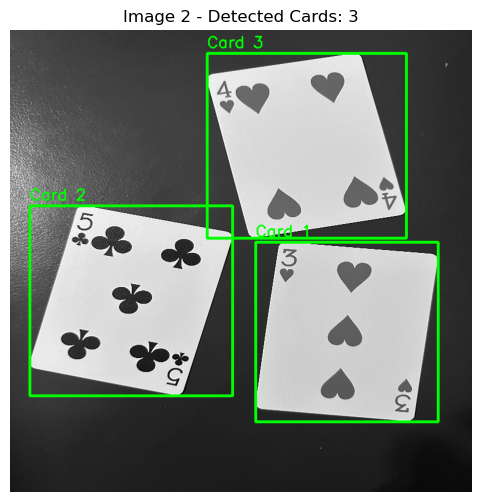

Saved output_cards/nate_image2_card_1.jpg
Saved output_cards/nate_image2_card_2.jpg
Saved output_cards/nate_image2_card_3.jpg


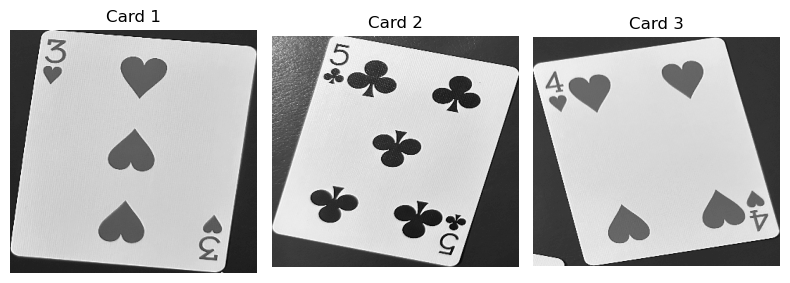

Image 3: Contours after area filtering: 3
Image 3: Final contours: 3


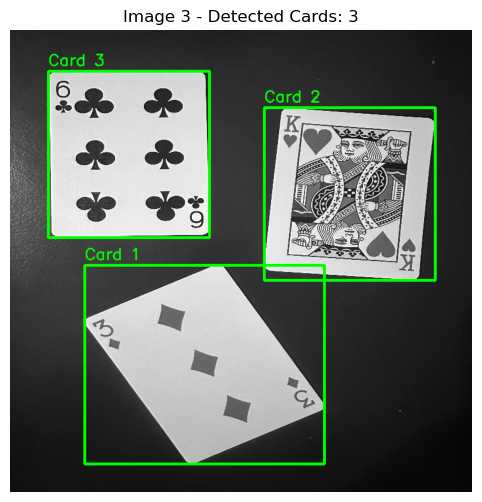

Saved output_cards/nate_image3_card_1.jpg
Saved output_cards/nate_image3_card_2.jpg
Saved output_cards/nate_image3_card_3.jpg


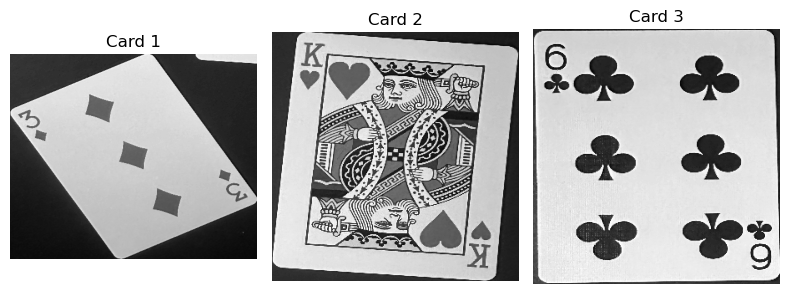

Image 4: Contours after area filtering: 3
Image 4: Final contours: 3


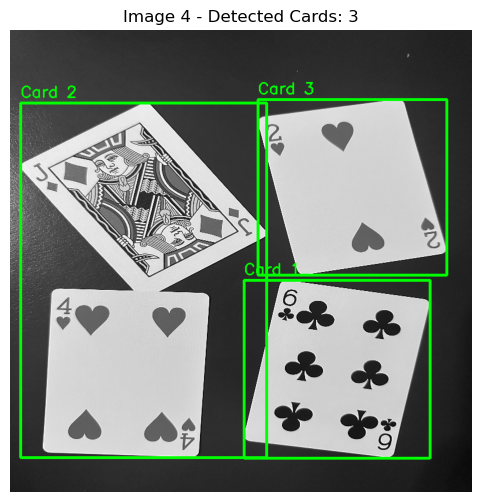

Saved output_cards/nate_image4_card_1.jpg
Saved output_cards/nate_image4_card_2.jpg
Saved output_cards/nate_image4_card_3.jpg


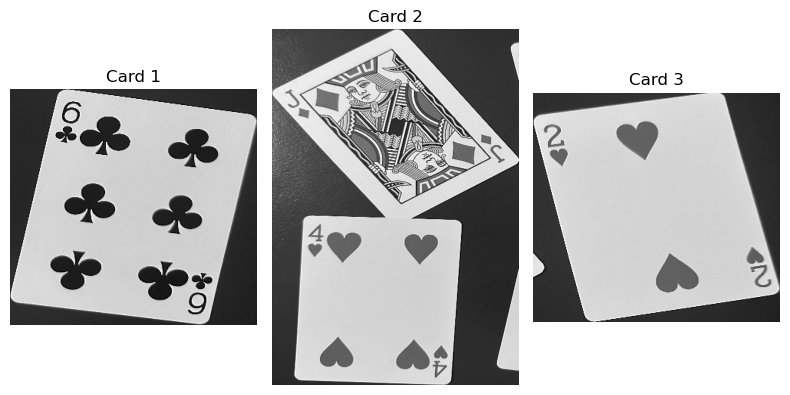

Image 5: Contours after area filtering: 3
Image 5: Final contours: 3


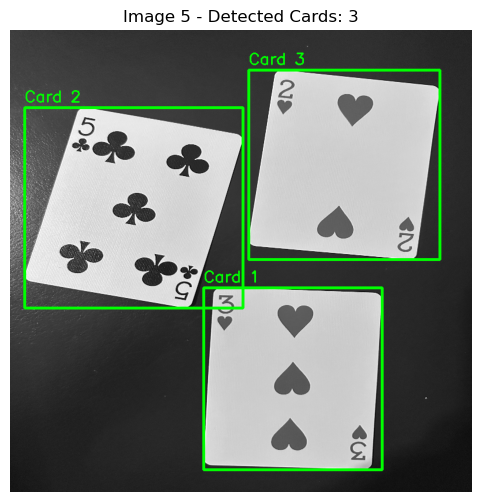

Saved output_cards/nate_image5_card_1.jpg
Saved output_cards/nate_image5_card_2.jpg
Saved output_cards/nate_image5_card_3.jpg


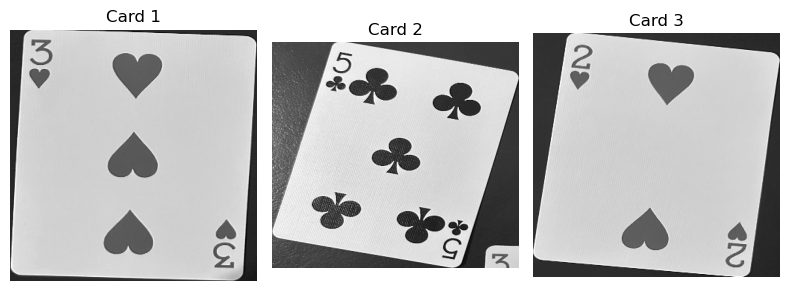

Image 6: Contours after area filtering: 3
Image 6: Final contours: 3


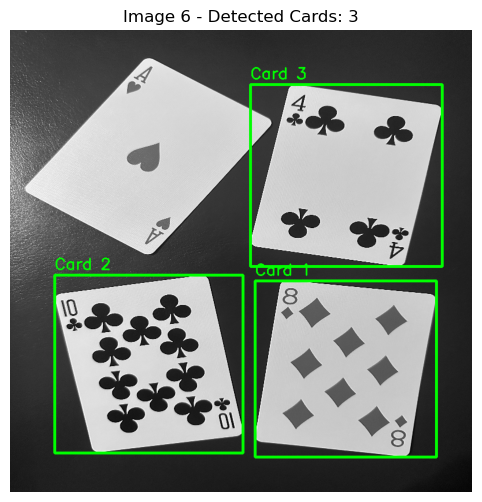

Saved output_cards/nate_image6_card_1.jpg
Saved output_cards/nate_image6_card_2.jpg
Saved output_cards/nate_image6_card_3.jpg


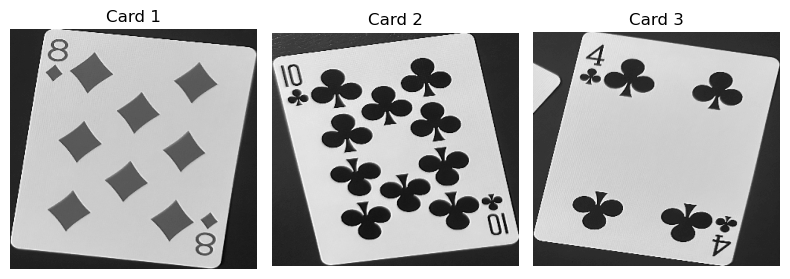

Image 7: Contours after area filtering: 1
Image 7: Final contours: 1


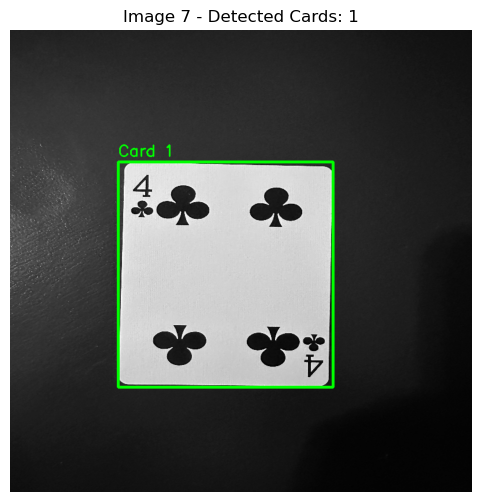

Saved output_cards/nate_image7_card_1.jpg


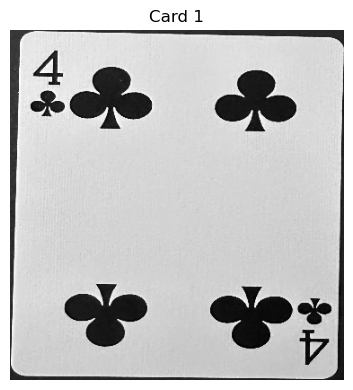

Image 8: Contours after area filtering: 1
Image 8: Final contours: 1


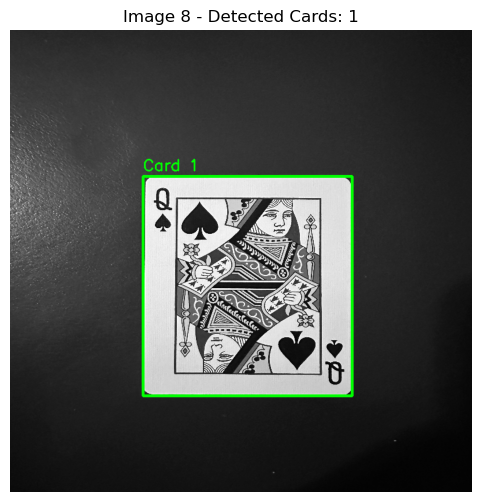

Saved output_cards/nate_image8_card_1.jpg


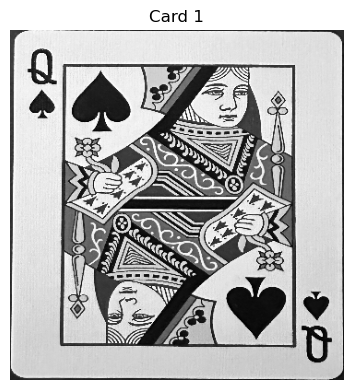

Image 9: Contours after area filtering: 1
Image 9: Final contours: 1


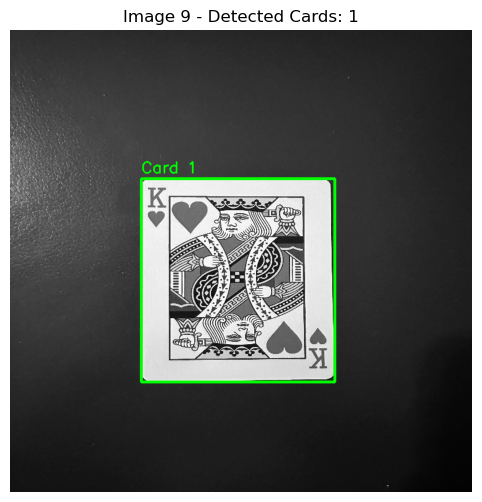

Saved output_cards/nate_image9_card_1.jpg


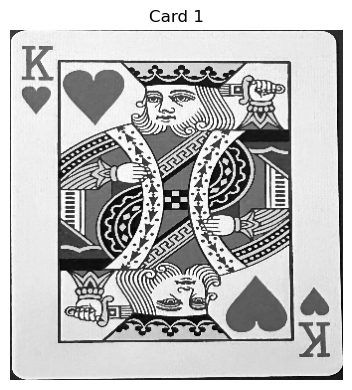

Image 10: Contours after area filtering: 2
Image 10: Final contours: 2


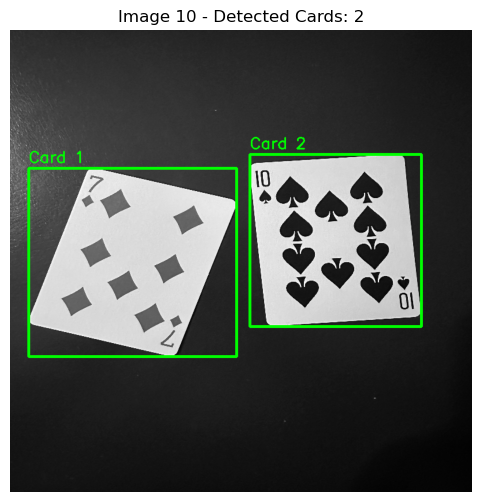

Saved output_cards/nate_image10_card_1.jpg
Saved output_cards/nate_image10_card_2.jpg


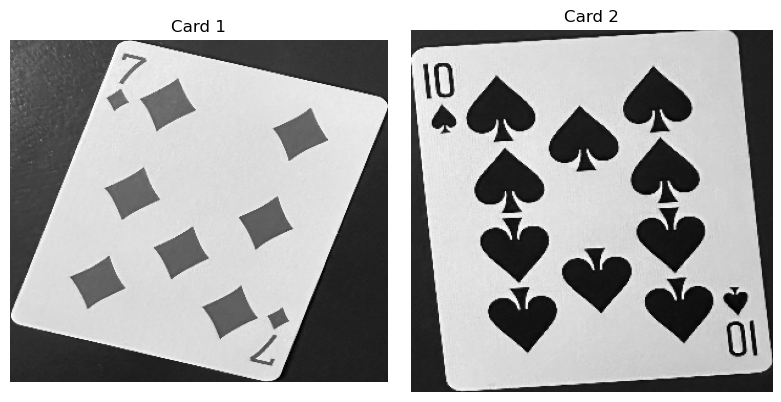

Image 11: Contours after area filtering: 2
Image 11: Final contours: 2


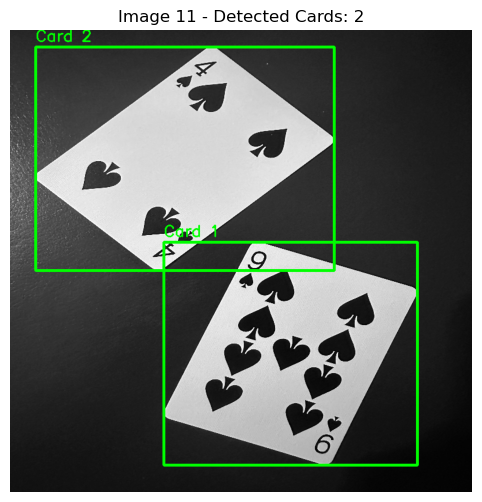

Saved output_cards/nate_image11_card_1.jpg
Saved output_cards/nate_image11_card_2.jpg


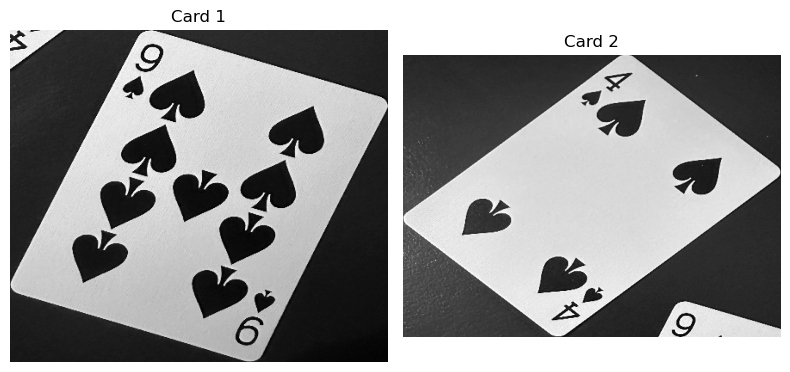

Image 12: Contours after area filtering: 2
Image 12: Final contours: 2


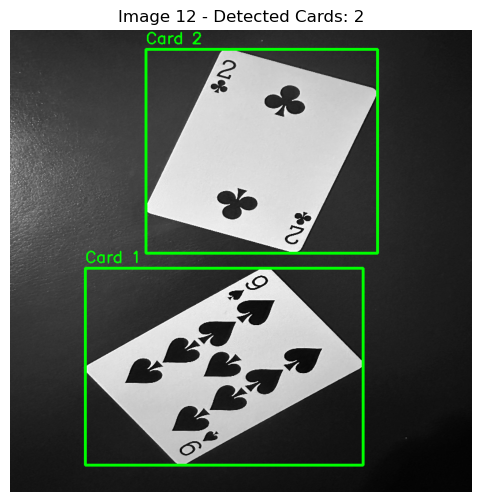

Saved output_cards/nate_image12_card_1.jpg
Saved output_cards/nate_image12_card_2.jpg


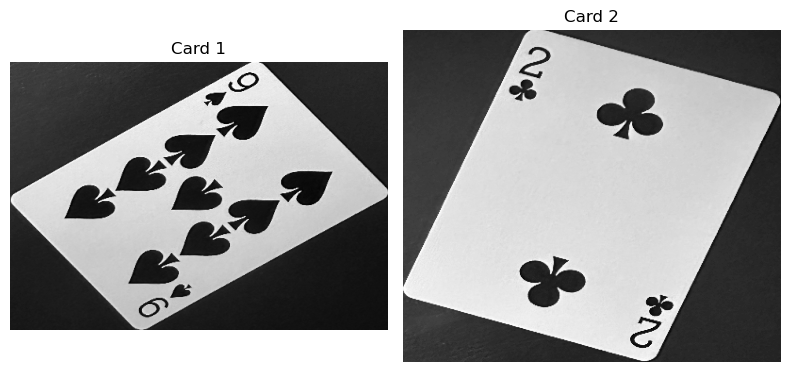

Image 13: Contours after area filtering: 2
Image 13: Final contours: 2


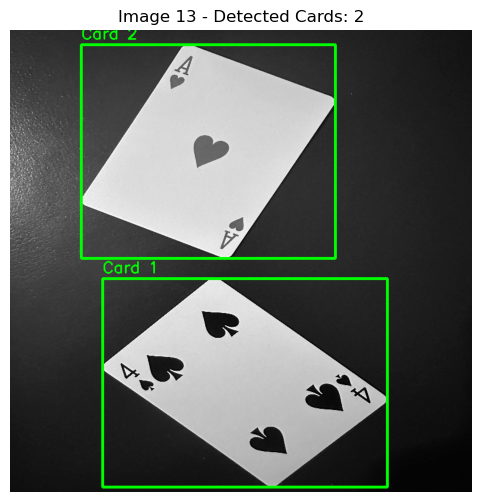

Saved output_cards/nate_image13_card_1.jpg
Saved output_cards/nate_image13_card_2.jpg


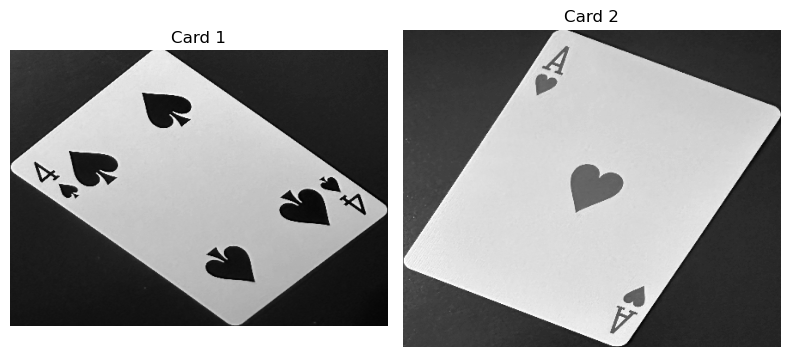

Image 14: Contours after area filtering: 1
Image 14: Final contours: 1


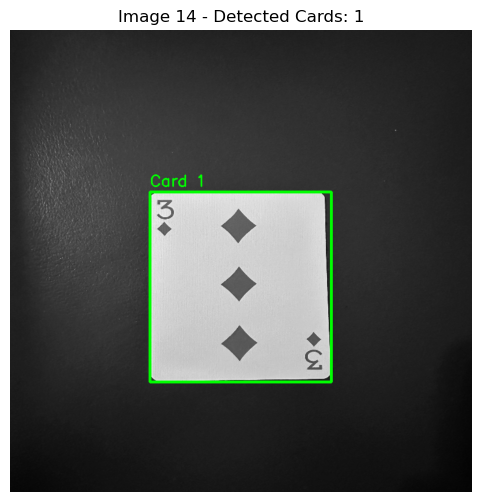

Saved output_cards/nate_image14_card_1.jpg


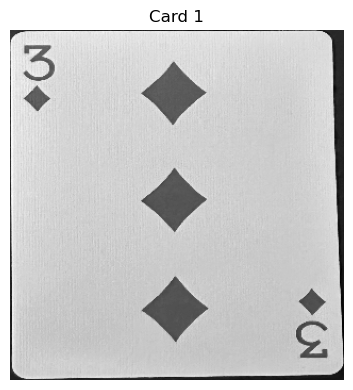

Image 15: Contours after area filtering: 1
Image 15: Final contours: 1


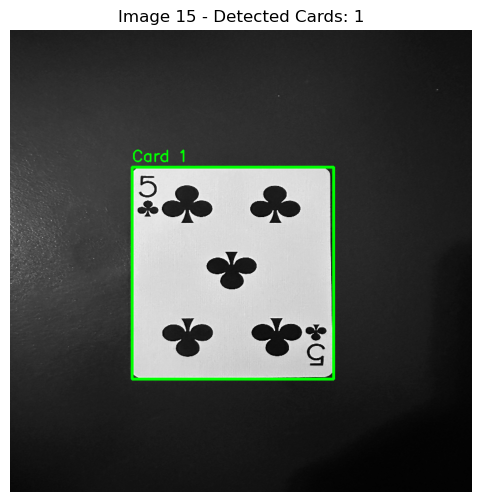

Saved output_cards/nate_image15_card_1.jpg


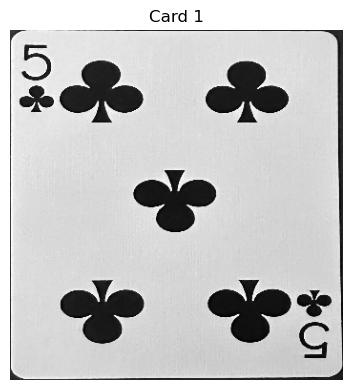

Image 16: Contours after area filtering: 1
Image 16: Final contours: 1


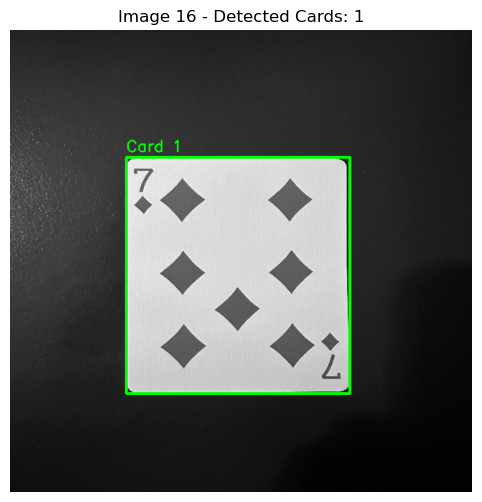

Saved output_cards/nate_image16_card_1.jpg


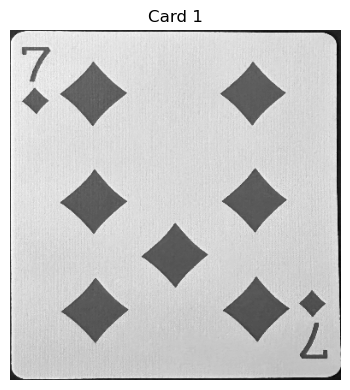

Image 17: Contours after area filtering: 1
Image 17: Final contours: 1


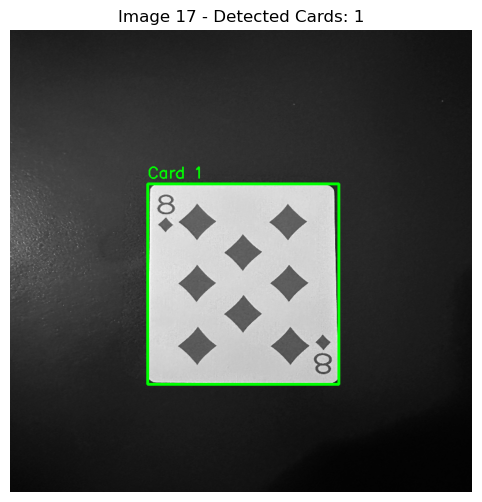

Saved output_cards/nate_image17_card_1.jpg


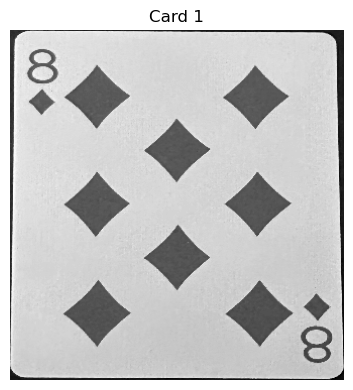

Image 18: Contours after area filtering: 1
Image 18: Final contours: 1


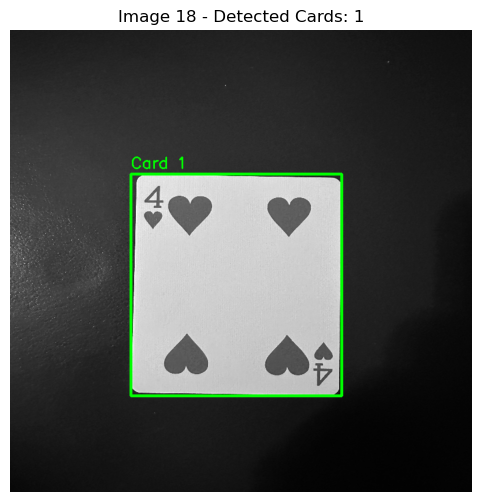

Saved output_cards/nate_image18_card_1.jpg


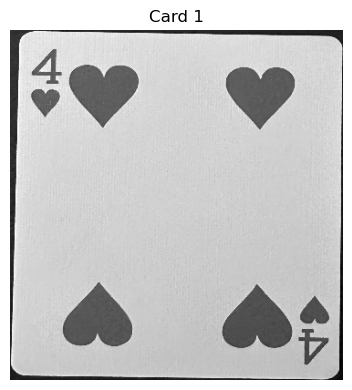

Image 19: Contours after area filtering: 2
Image 19: Final contours: 2


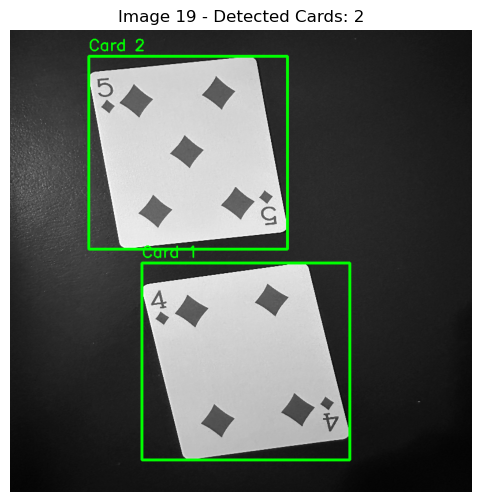

Saved output_cards/nate_image19_card_1.jpg
Saved output_cards/nate_image19_card_2.jpg


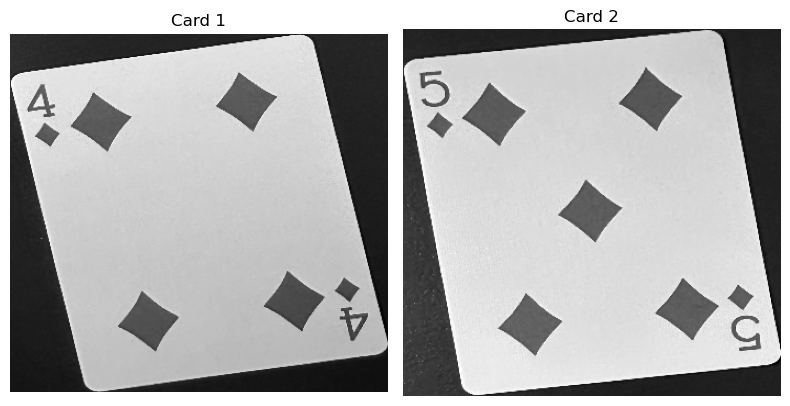

Image 20: Contours after area filtering: 2
Image 20: Final contours: 2


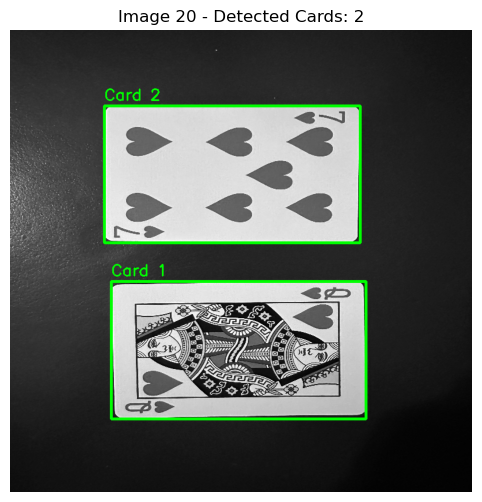

Saved output_cards/nate_image20_card_1.jpg
Saved output_cards/nate_image20_card_2.jpg


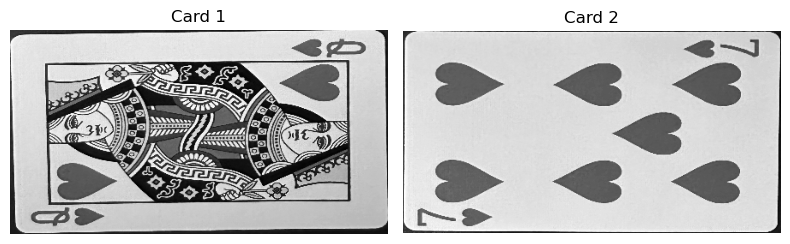

Image 21: Contours after area filtering: 3
Image 21: Final contours: 3


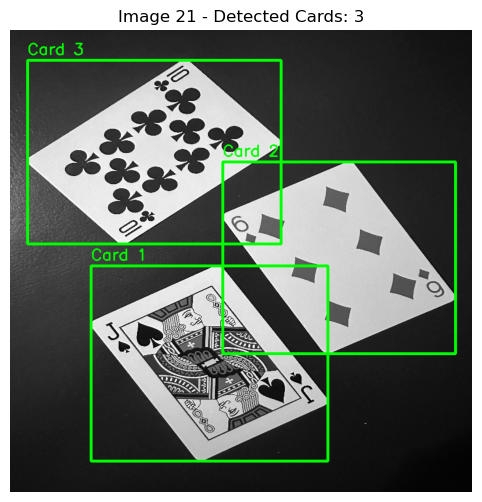

Saved output_cards/nate_image21_card_1.jpg
Saved output_cards/nate_image21_card_2.jpg
Saved output_cards/nate_image21_card_3.jpg


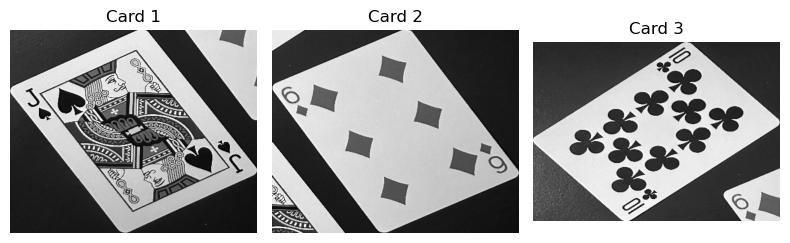

Image 22: Contours after area filtering: 2
Image 22: Final contours: 2


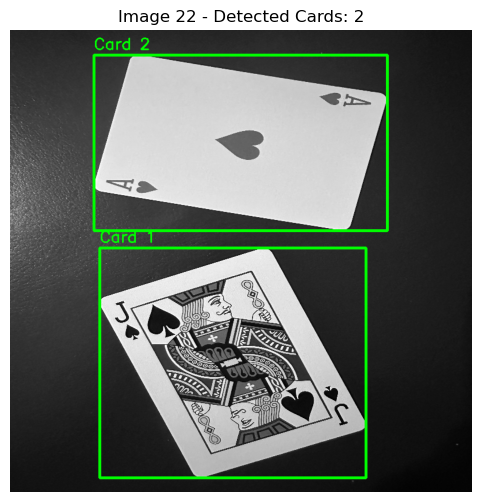

Saved output_cards/nate_image22_card_1.jpg
Saved output_cards/nate_image22_card_2.jpg


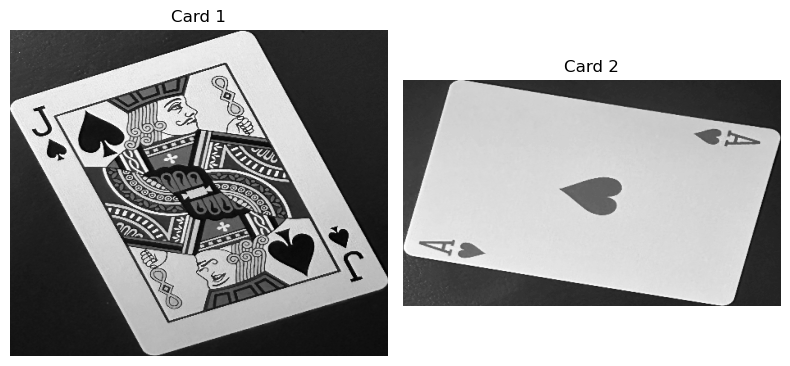

Image 23: Contours after area filtering: 2
Image 23: Final contours: 2


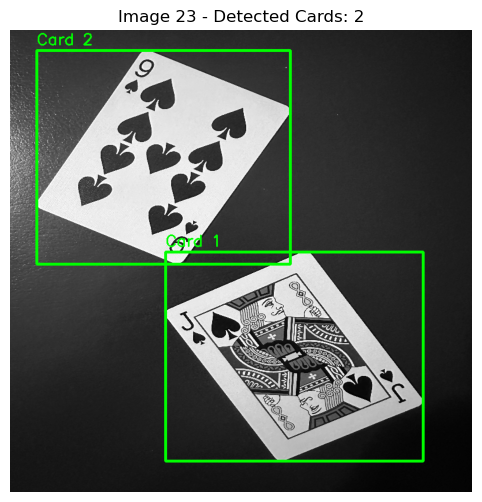

Saved output_cards/nate_image23_card_1.jpg
Saved output_cards/nate_image23_card_2.jpg


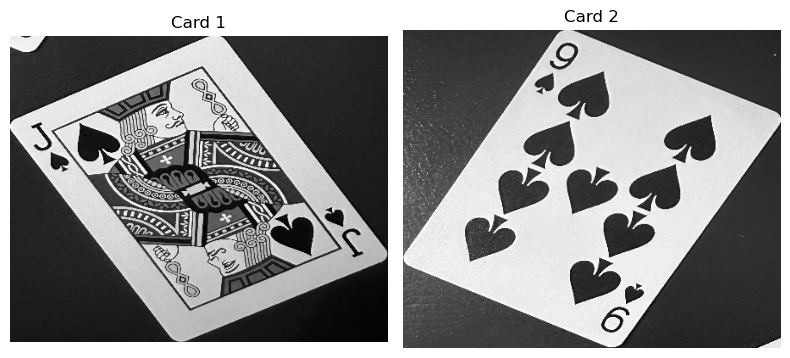

Image 24: Contours after area filtering: 3
Image 24: Final contours: 3


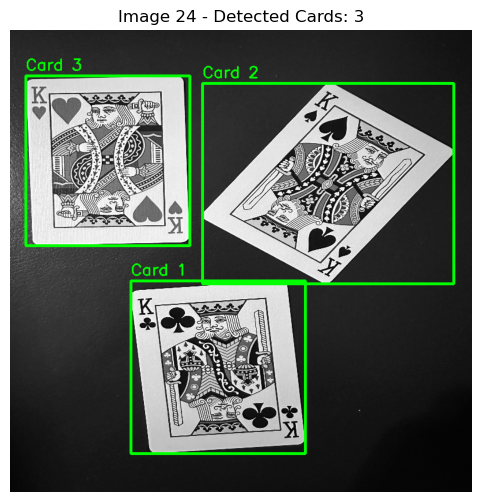

Saved output_cards/nate_image24_card_1.jpg
Saved output_cards/nate_image24_card_2.jpg
Saved output_cards/nate_image24_card_3.jpg


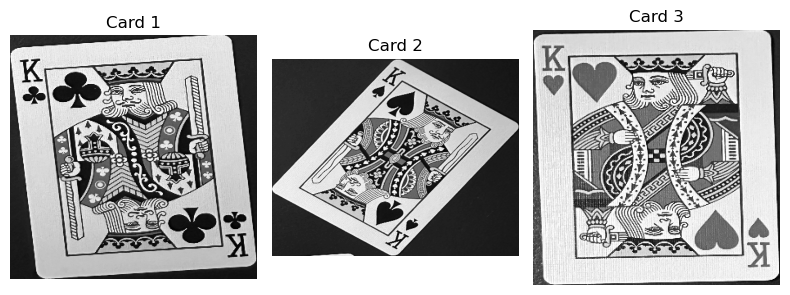

Image 25: Contours after area filtering: 1
Image 25: Final contours: 1


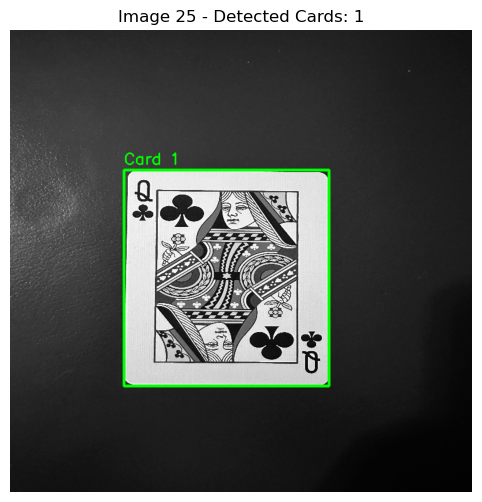

Saved output_cards/nate_image25_card_1.jpg


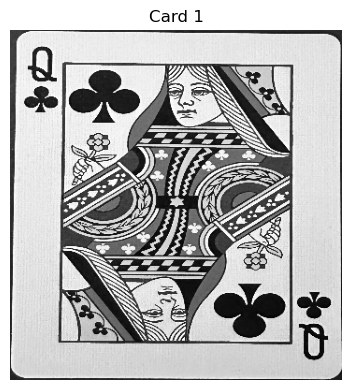

Image 26: Contours after area filtering: 1
Image 26: Final contours: 1


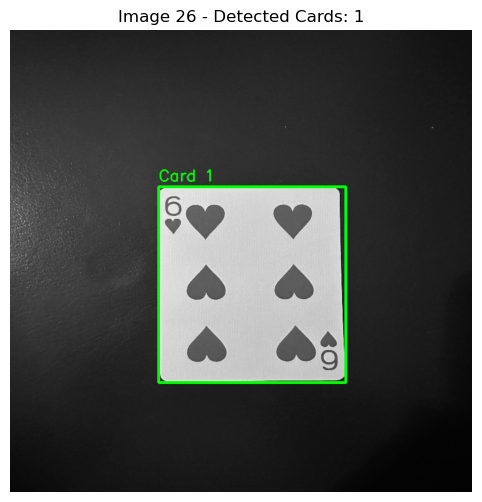

Saved output_cards/nate_image26_card_1.jpg


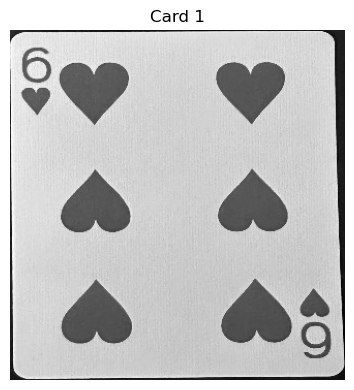

Image 27: Contours after area filtering: 1
Image 27: Final contours: 1


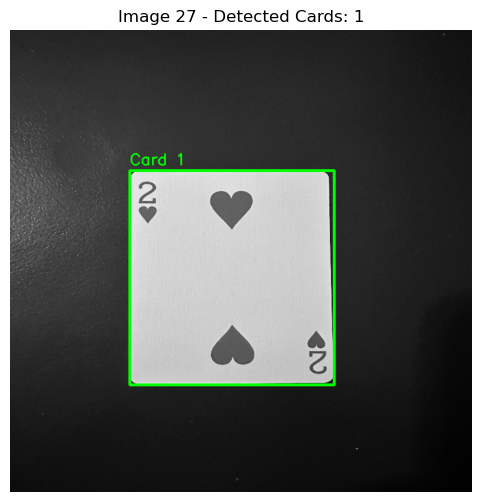

Saved output_cards/nate_image27_card_1.jpg


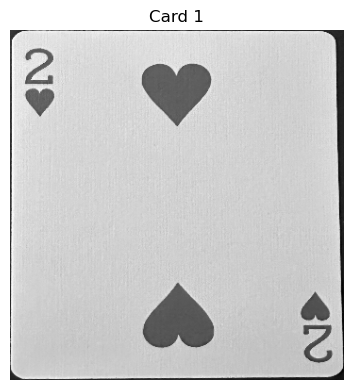

Image 28: Contours after area filtering: 1
Image 28: Final contours: 1


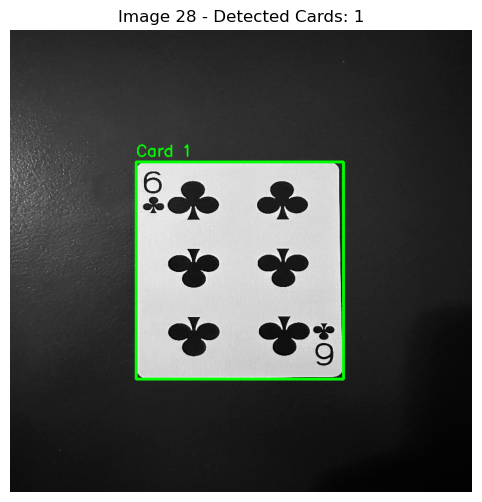

Saved output_cards/nate_image28_card_1.jpg


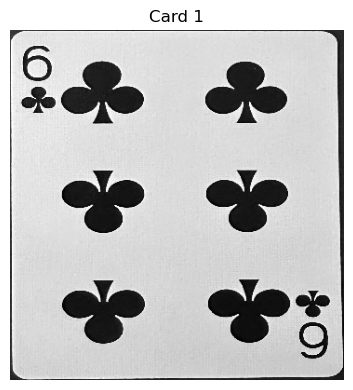

Image 29: Contours after area filtering: 2
Image 29: Final contours: 2


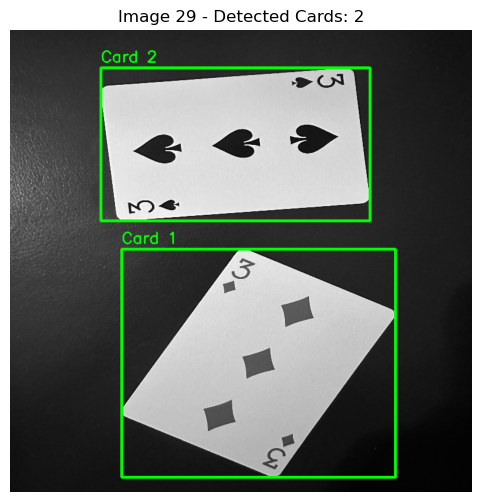

Saved output_cards/nate_image29_card_1.jpg
Saved output_cards/nate_image29_card_2.jpg


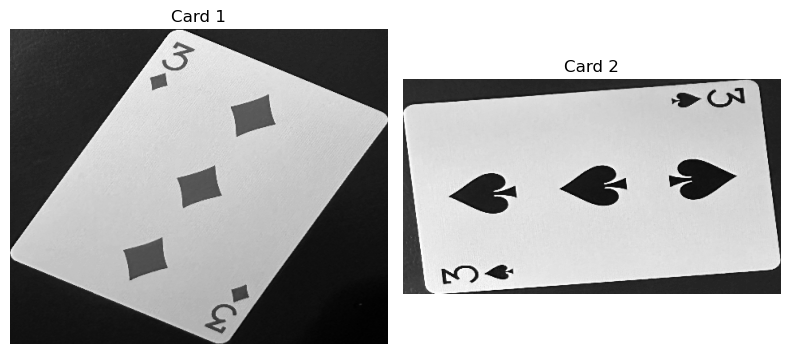

Image 30: Contours after area filtering: 2
Image 30: Final contours: 2


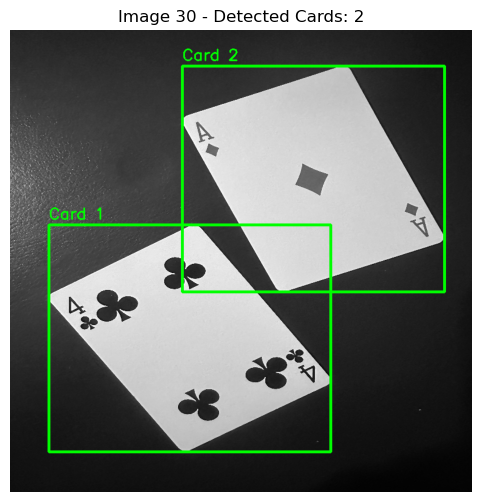

Saved output_cards/nate_image30_card_1.jpg
Saved output_cards/nate_image30_card_2.jpg


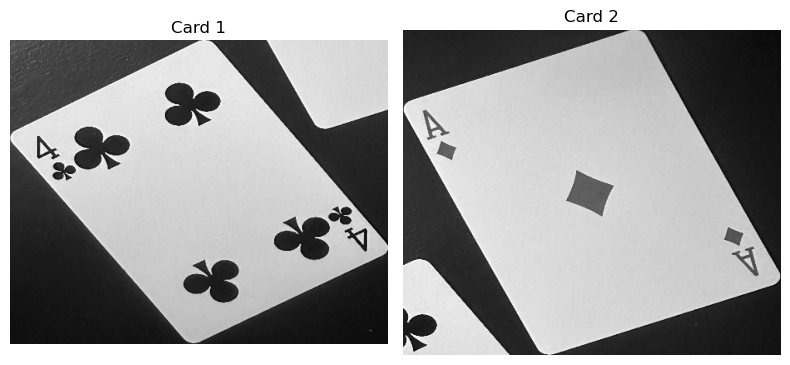

Image 31: Contours after area filtering: 2
Image 31: Final contours: 2


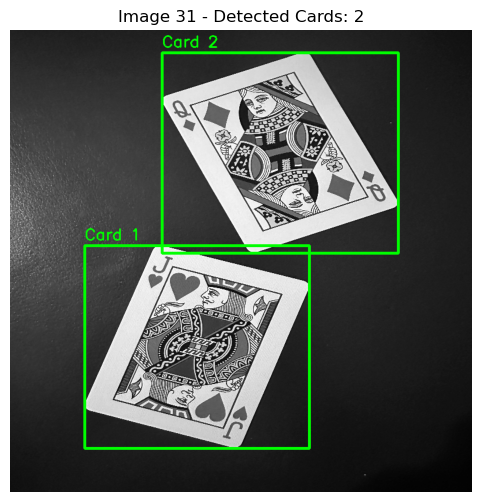

Saved output_cards/nate_image31_card_1.jpg
Saved output_cards/nate_image31_card_2.jpg


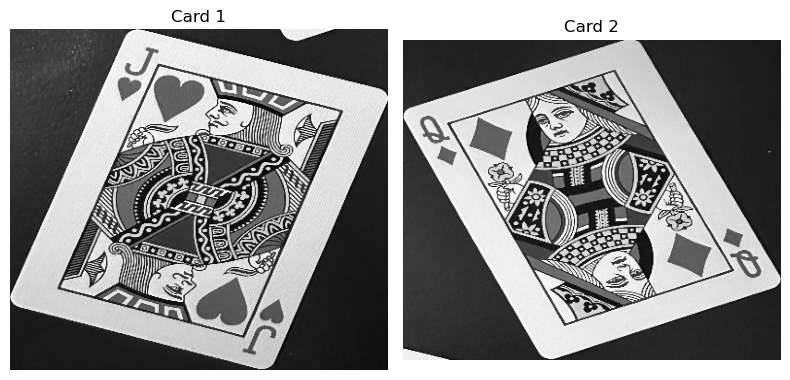

Image 32: Contours after area filtering: 1
Image 32: Final contours: 1


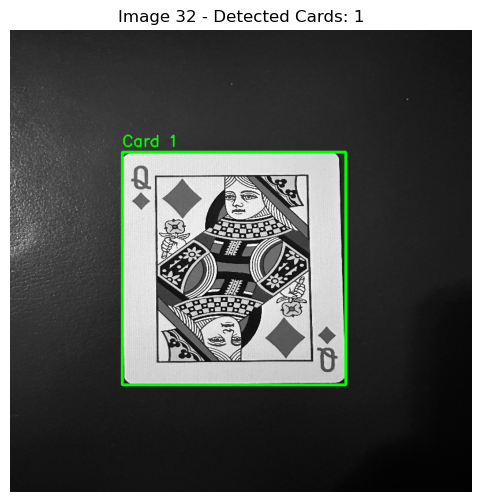

Saved output_cards/nate_image32_card_1.jpg


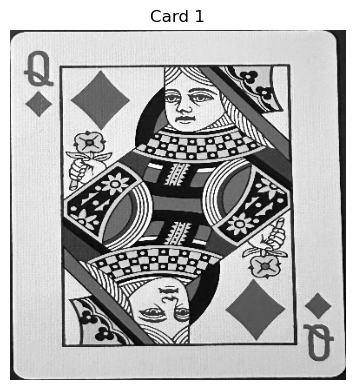

Image 33: Contours after area filtering: 2
Image 33: Final contours: 2


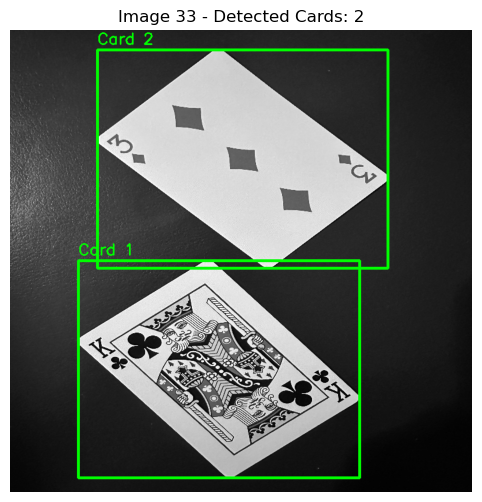

Saved output_cards/nate_image33_card_1.jpg
Saved output_cards/nate_image33_card_2.jpg


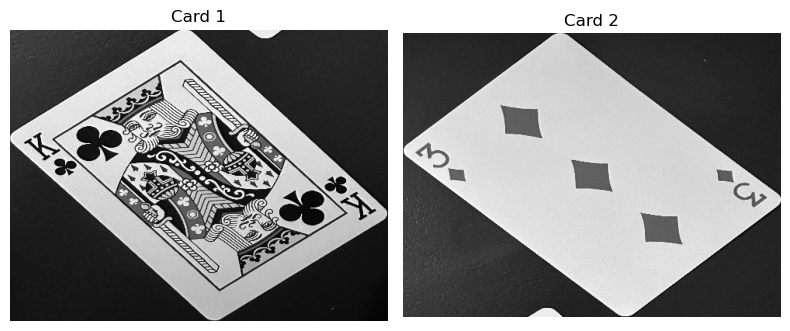

Image 34: Contours after area filtering: 1
Image 34: Final contours: 1


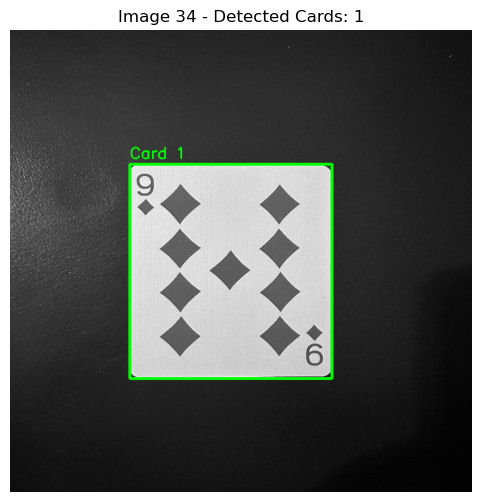

Saved output_cards/nate_image34_card_1.jpg


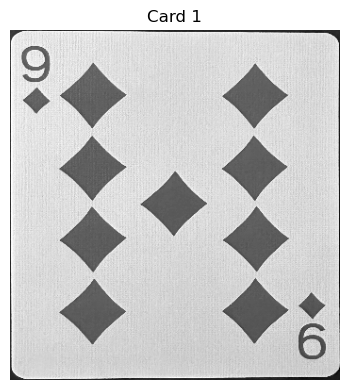

Image 35: Contours after area filtering: 1
Image 35: Final contours: 1


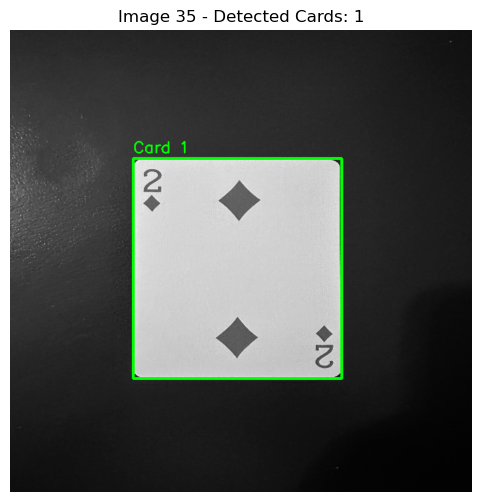

Saved output_cards/nate_image35_card_1.jpg


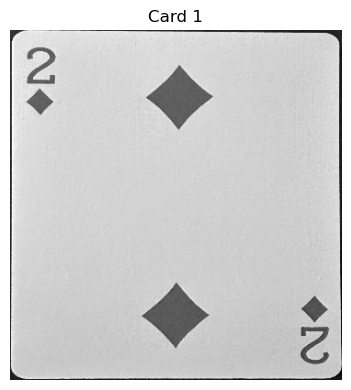

Image 36: Contours after area filtering: 1
Image 36: Final contours: 1


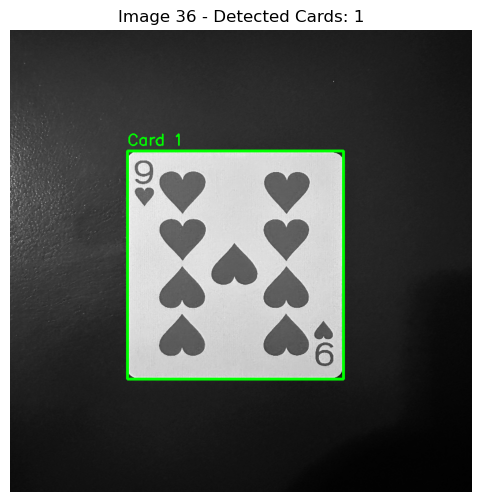

Saved output_cards/nate_image36_card_1.jpg


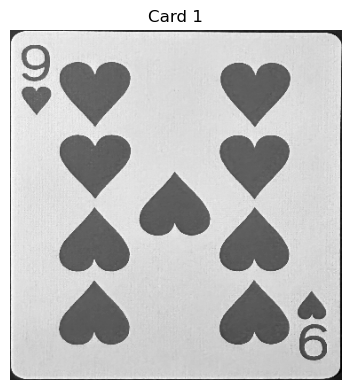

Image 37: Contours after area filtering: 3
Image 37: Final contours: 3


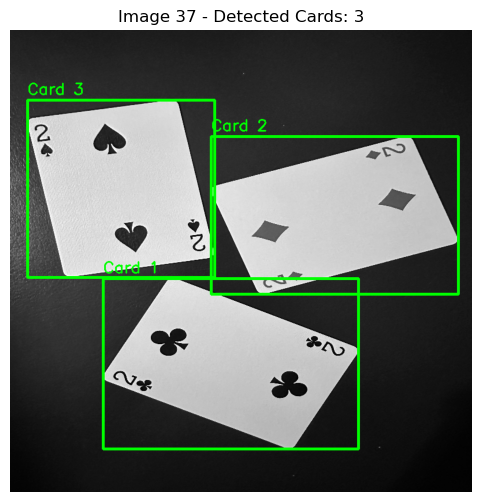

Saved output_cards/nate_image37_card_1.jpg
Saved output_cards/nate_image37_card_2.jpg
Saved output_cards/nate_image37_card_3.jpg


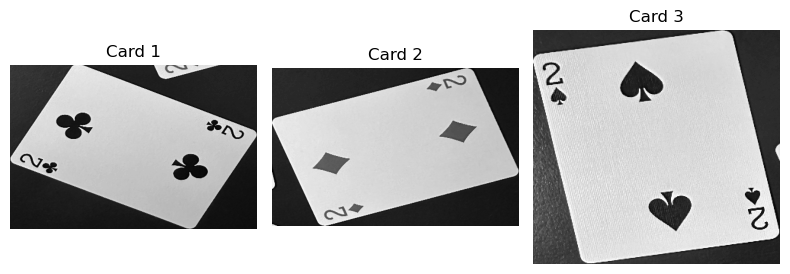

Image 38: Contours after area filtering: 1
Image 38: Final contours: 1


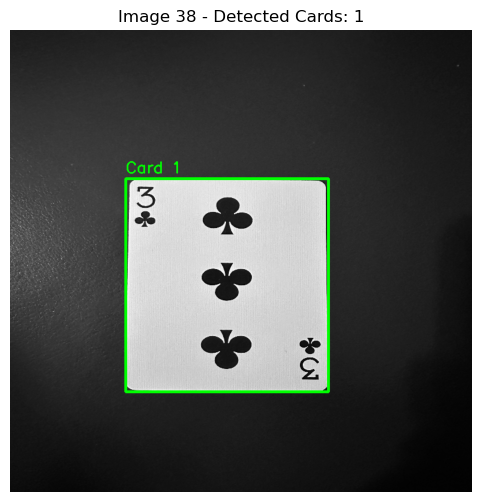

Saved output_cards/nate_image38_card_1.jpg


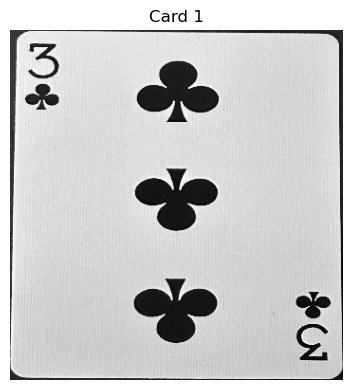

Image 39: Contours after area filtering: 1
Image 39: Final contours: 1


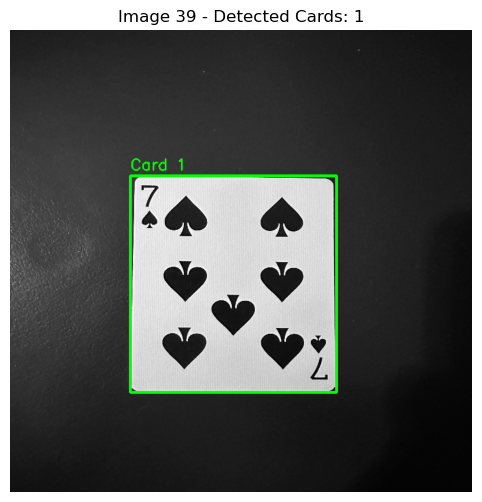

Saved output_cards/nate_image39_card_1.jpg


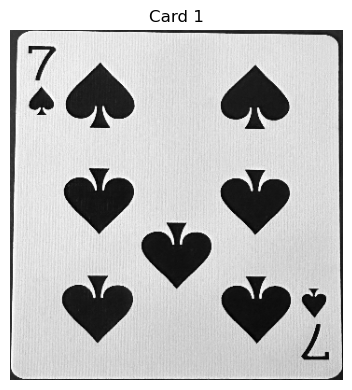

Image 40: Contours after area filtering: 2
Image 40: Final contours: 2


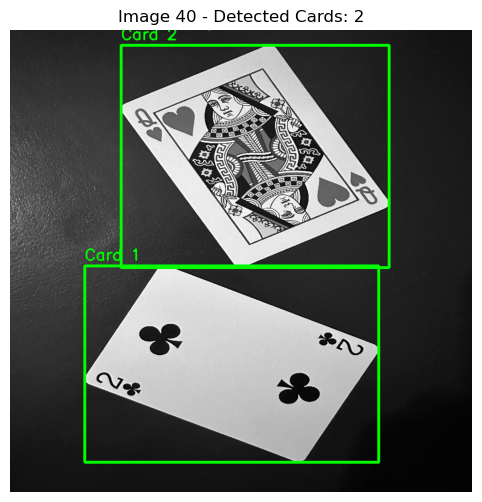

Saved output_cards/nate_image40_card_1.jpg
Saved output_cards/nate_image40_card_2.jpg


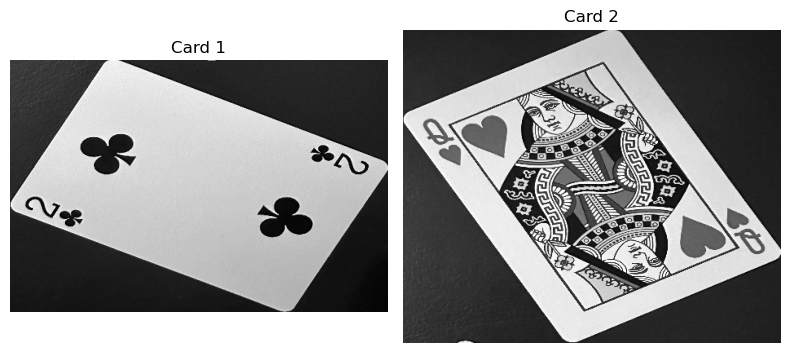

Image 41: Contours after area filtering: 1
Image 41: Final contours: 1


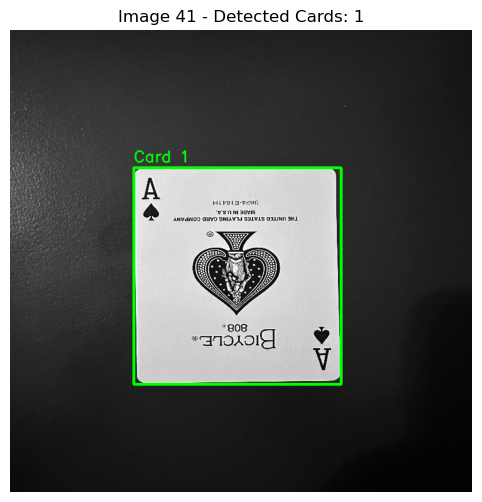

Saved output_cards/nate_image41_card_1.jpg


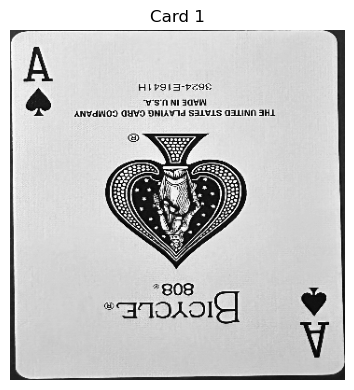

Image 42: Contours after area filtering: 1
Image 42: Final contours: 1


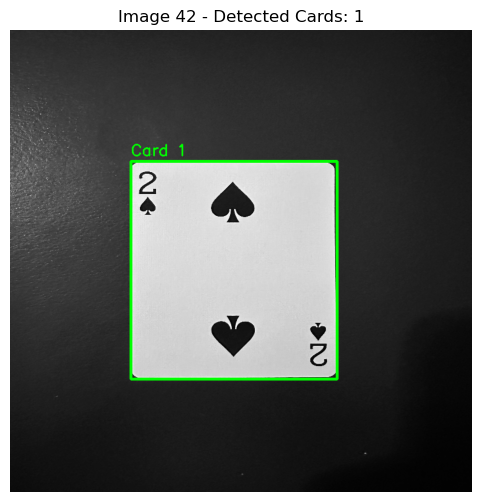

Saved output_cards/nate_image42_card_1.jpg


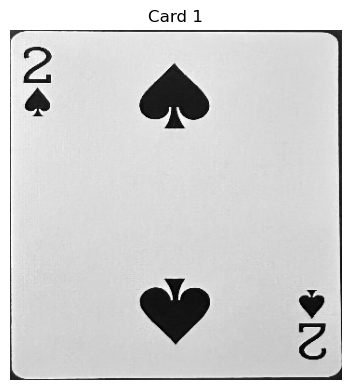

Image 43: Contours after area filtering: 1
Image 43: Final contours: 1


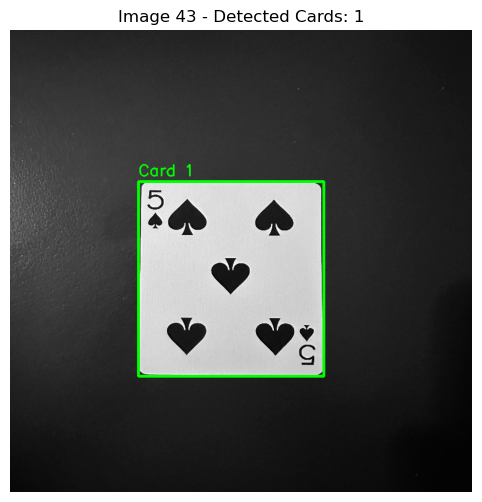

Saved output_cards/nate_image43_card_1.jpg


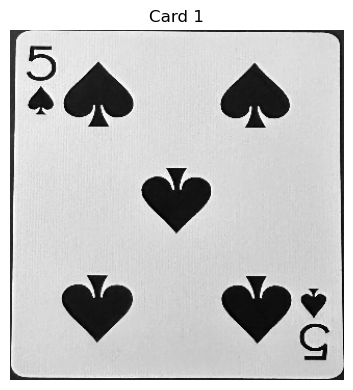

Image 44: Contours after area filtering: 2
Image 44: Final contours: 2


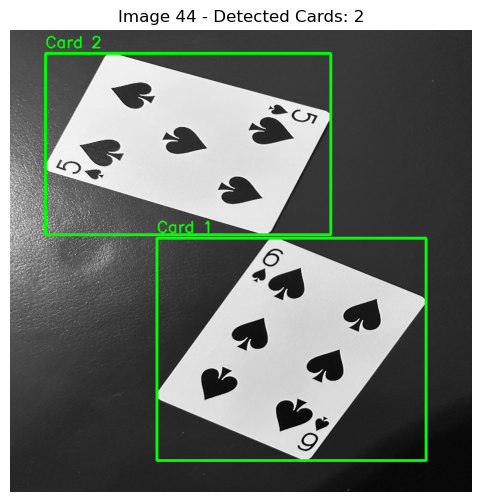

Saved output_cards/nate_image44_card_1.jpg
Saved output_cards/nate_image44_card_2.jpg


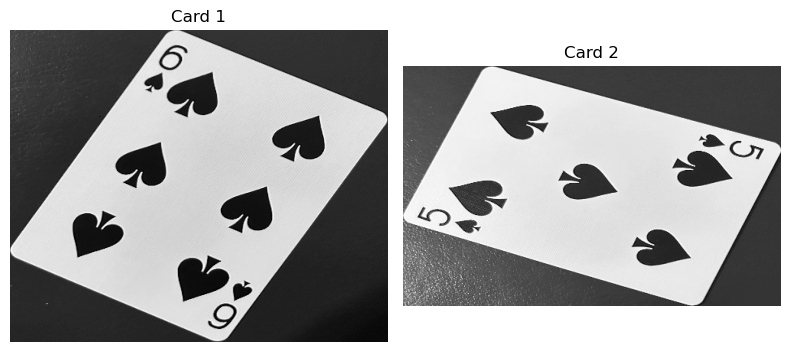

Image 45: Contours after area filtering: 1
Image 45: Final contours: 1


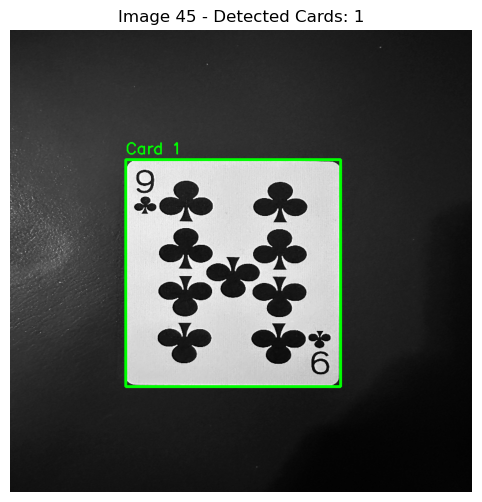

Saved output_cards/nate_image45_card_1.jpg


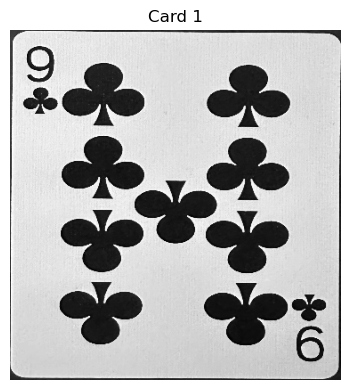

Image 46: Contours after area filtering: 1
Image 46: Final contours: 1


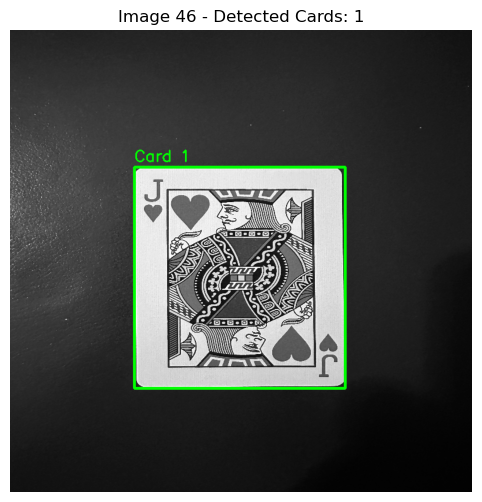

Saved output_cards/nate_image46_card_1.jpg


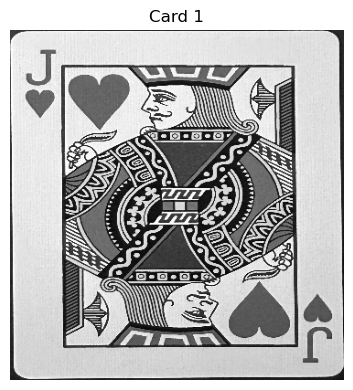

Image 47: Contours after area filtering: 1
Image 47: Final contours: 1


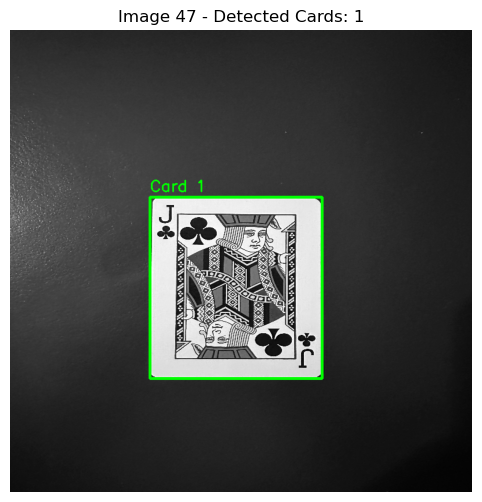

Saved output_cards/nate_image47_card_1.jpg


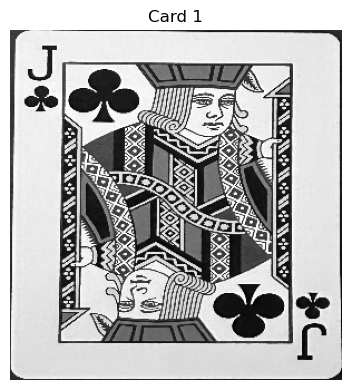

Image 48: Contours after area filtering: 1
Image 48: Final contours: 1


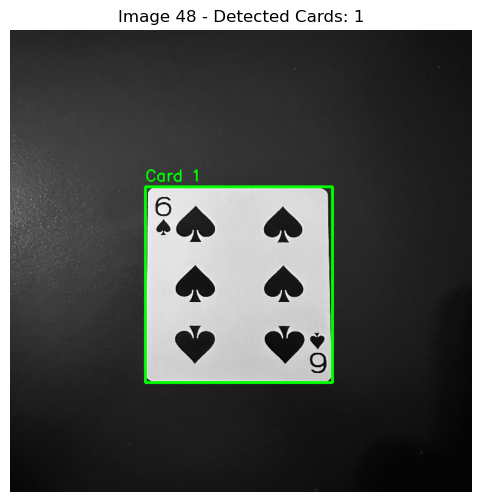

Saved output_cards/nate_image48_card_1.jpg


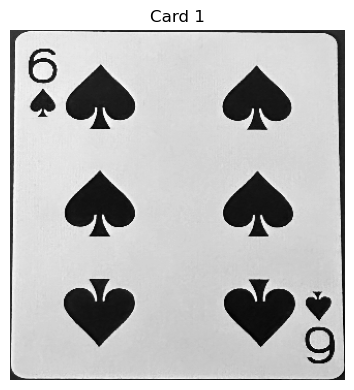

Image 49: Contours after area filtering: 2
Image 49: Final contours: 2


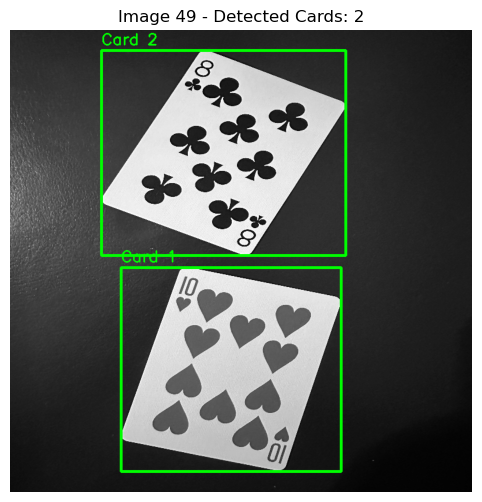

Saved output_cards/nate_image49_card_1.jpg
Saved output_cards/nate_image49_card_2.jpg


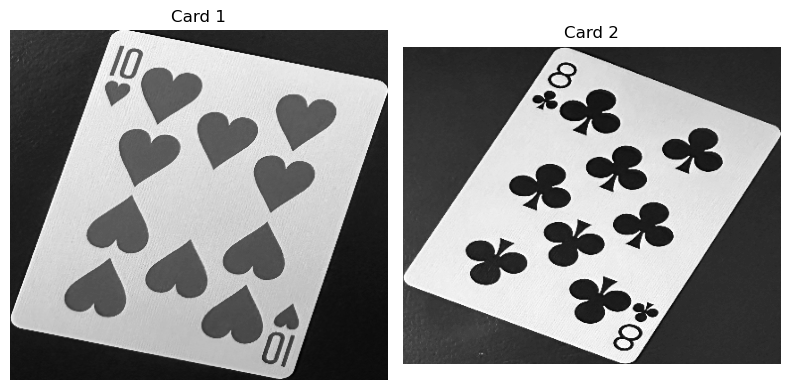

Image 50: Contours after area filtering: 1
Image 50: Final contours: 1


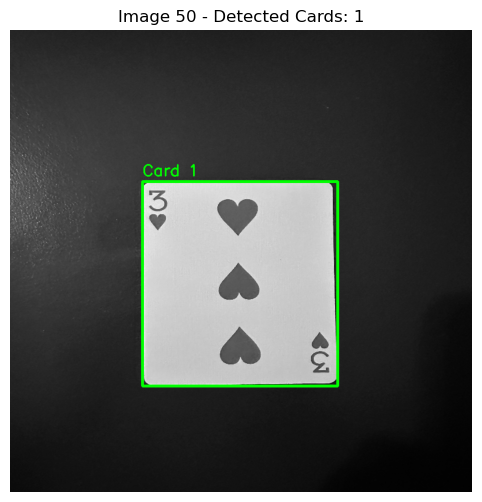

Saved output_cards/nate_image50_card_1.jpg


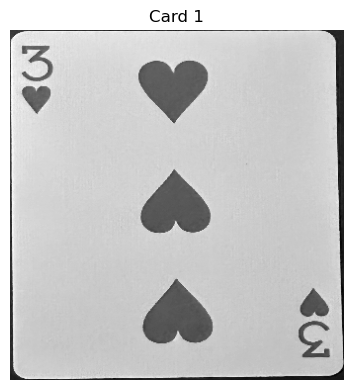

Image 51: Contours after area filtering: 4
Image 51: Final contours: 4


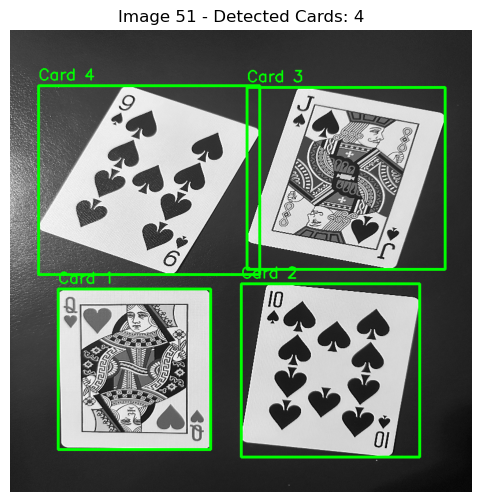

Saved output_cards/nate_image51_card_1.jpg
Saved output_cards/nate_image51_card_2.jpg
Saved output_cards/nate_image51_card_3.jpg
Saved output_cards/nate_image51_card_4.jpg


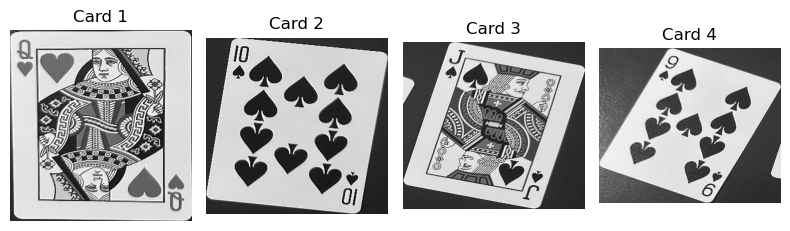

Image 52: Contours after area filtering: 1
Image 52: Final contours: 1


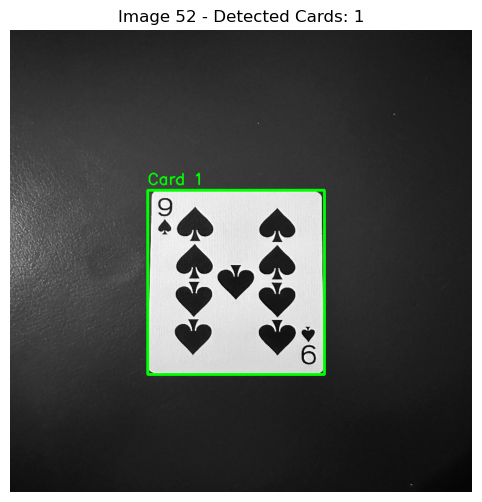

Saved output_cards/nate_image52_card_1.jpg


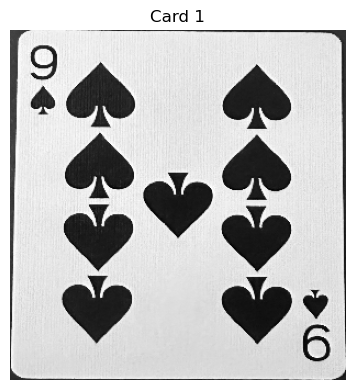

Image 53: Contours after area filtering: 1
Image 53: Final contours: 1


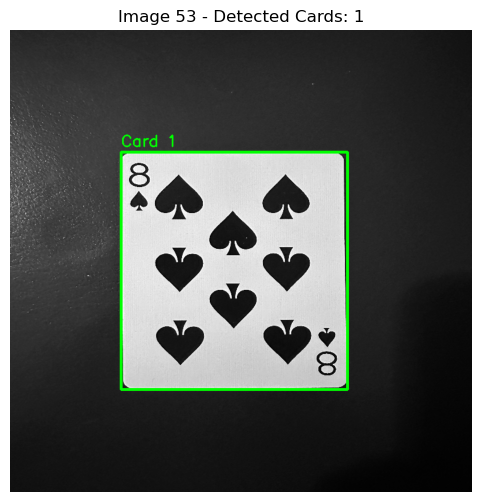

Saved output_cards/nate_image53_card_1.jpg


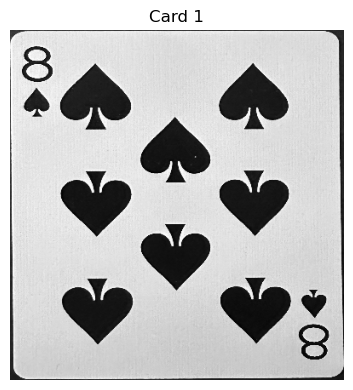

Image 54: Contours after area filtering: 2
Image 54: Final contours: 2


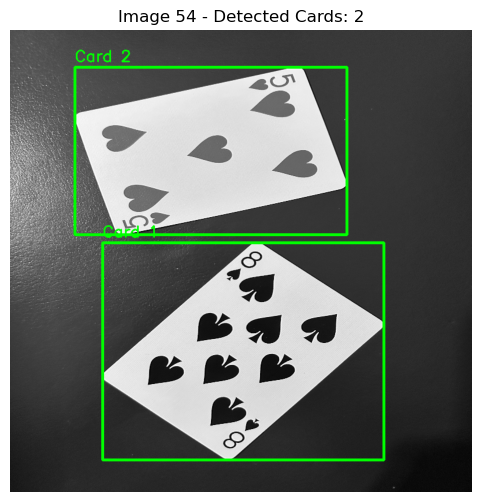

Saved output_cards/nate_image54_card_1.jpg
Saved output_cards/nate_image54_card_2.jpg


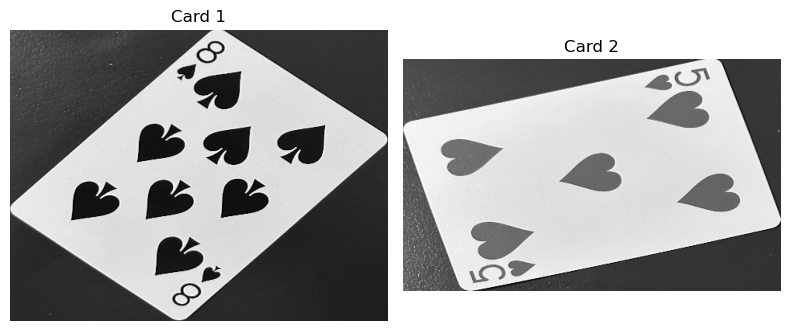

Image 55: Contours after area filtering: 1
Image 55: Final contours: 1


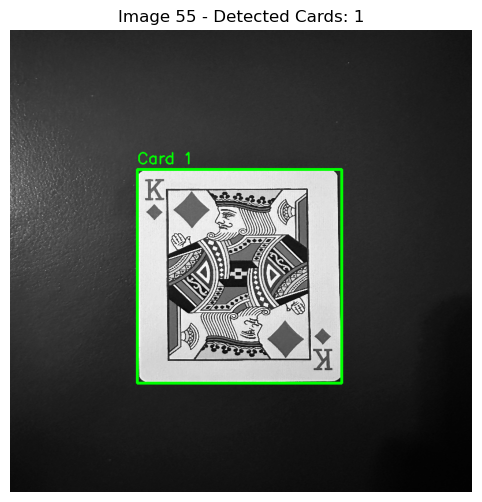

Saved output_cards/nate_image55_card_1.jpg


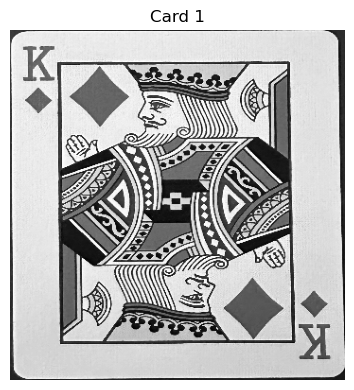

Image 56: Contours after area filtering: 3
Image 56: Final contours: 3


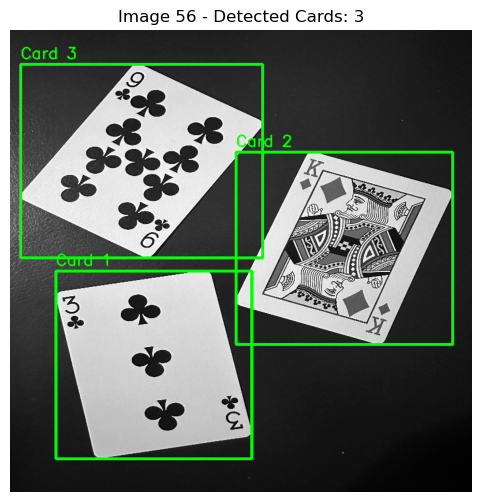

Saved output_cards/nate_image56_card_1.jpg
Saved output_cards/nate_image56_card_2.jpg
Saved output_cards/nate_image56_card_3.jpg


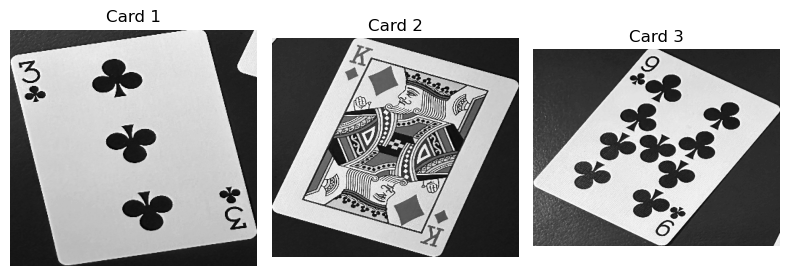

Image 57: Contours after area filtering: 1
Image 57: Final contours: 1


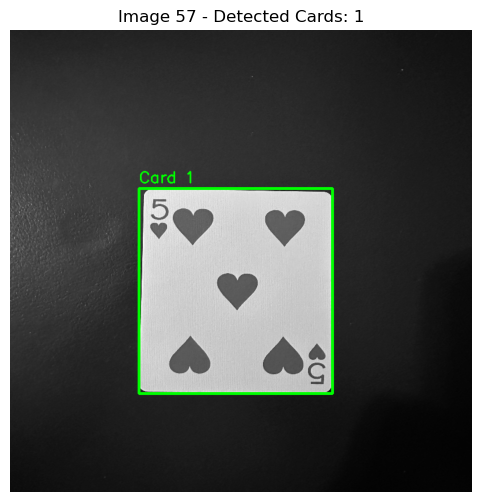

Saved output_cards/nate_image57_card_1.jpg


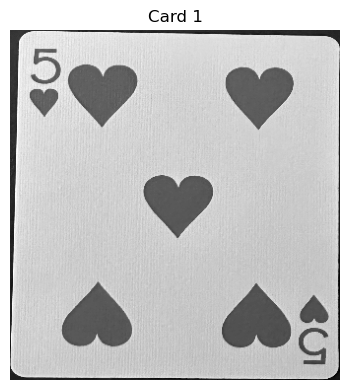

Image 58: Contours after area filtering: 1
Image 58: Final contours: 1


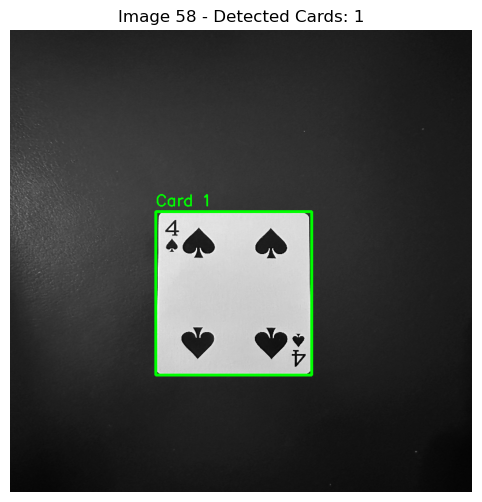

Saved output_cards/nate_image58_card_1.jpg


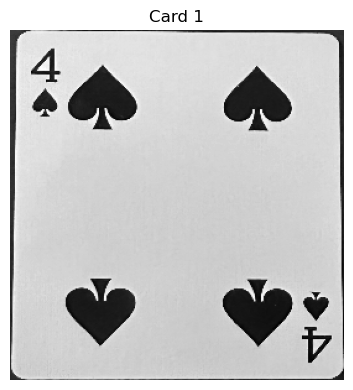

Image 59: Contours after area filtering: 1
Image 59: Final contours: 1


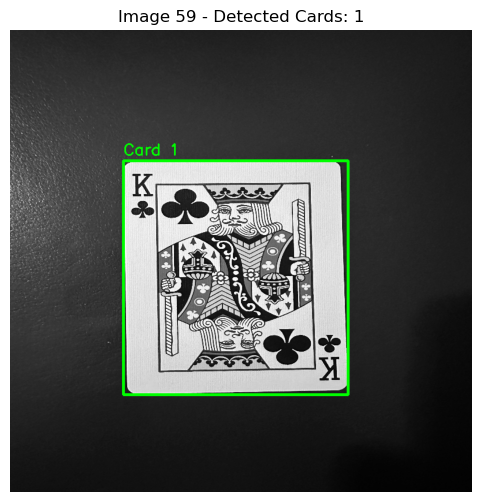

Saved output_cards/nate_image59_card_1.jpg


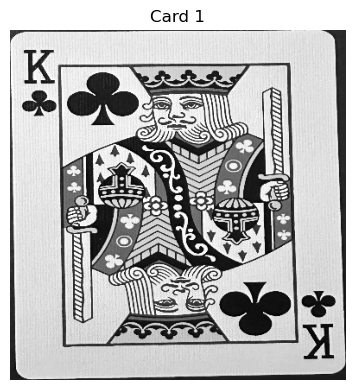

Image 60: Contours after area filtering: 1
Image 60: Final contours: 1


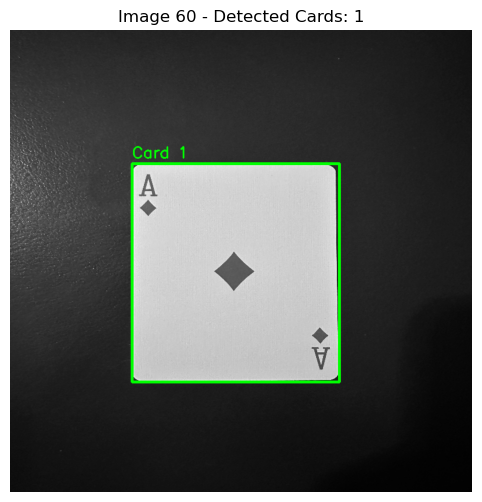

Saved output_cards/nate_image60_card_1.jpg


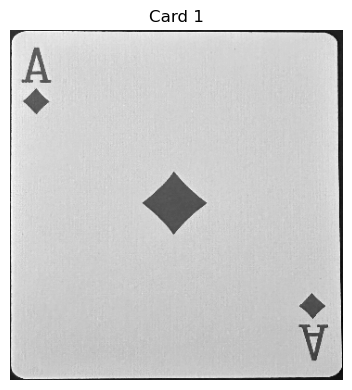

Image 61: Contours after area filtering: 1
Image 61: Final contours: 1


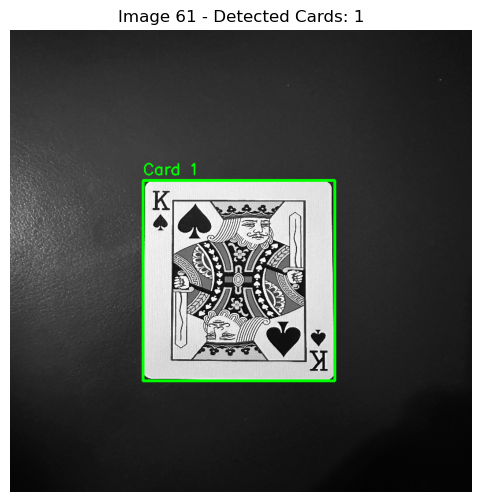

Saved output_cards/nate_image61_card_1.jpg


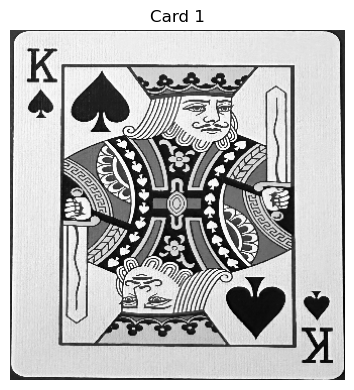

Image 62: Contours after area filtering: 1
Image 62: Final contours: 1


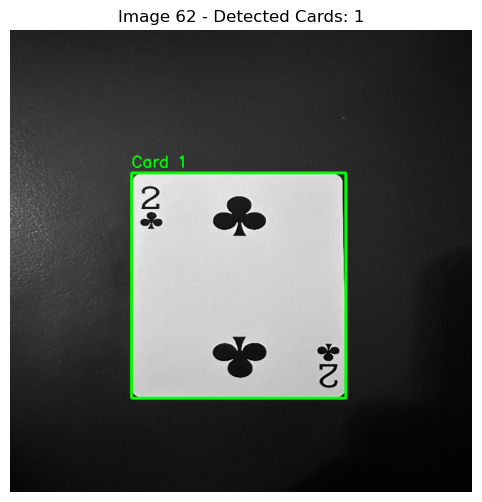

Saved output_cards/nate_image62_card_1.jpg


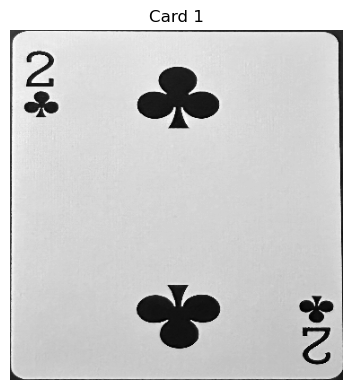

Image 63: Contours after area filtering: 1
Image 63: Final contours: 1


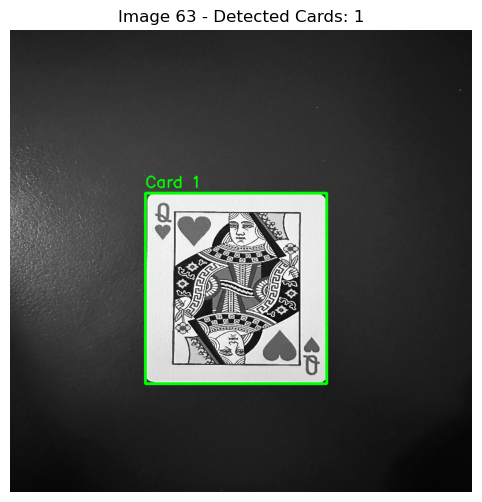

Saved output_cards/nate_image63_card_1.jpg


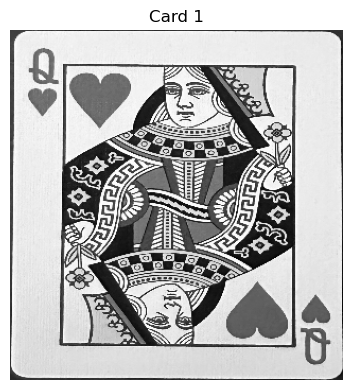

Image 64: Contours after area filtering: 1
Image 64: Final contours: 1


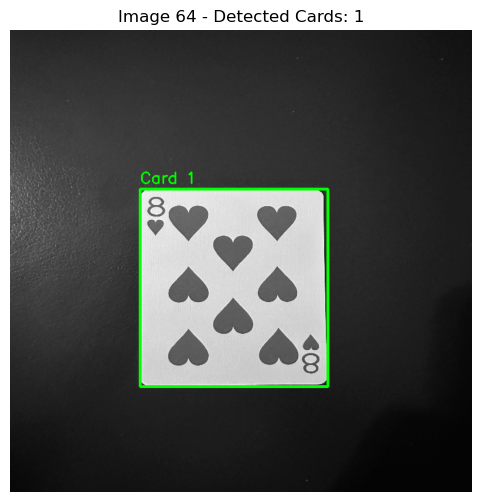

Saved output_cards/nate_image64_card_1.jpg


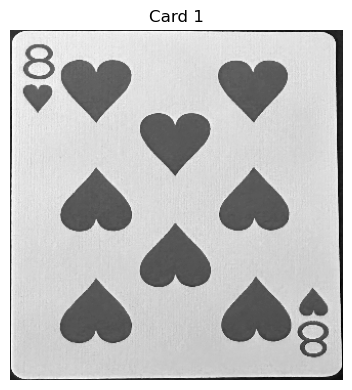

Image 65: Contours after area filtering: 2
Image 65: Final contours: 2


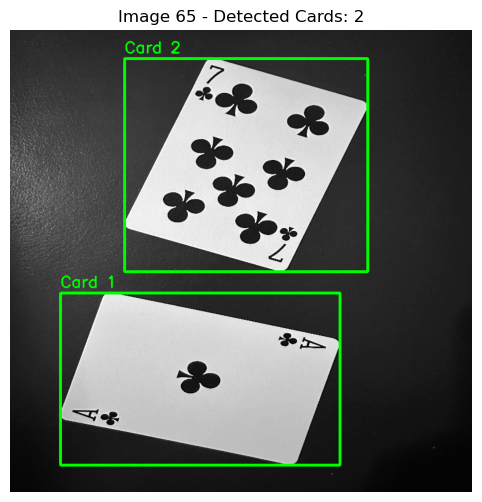

Saved output_cards/nate_image65_card_1.jpg
Saved output_cards/nate_image65_card_2.jpg


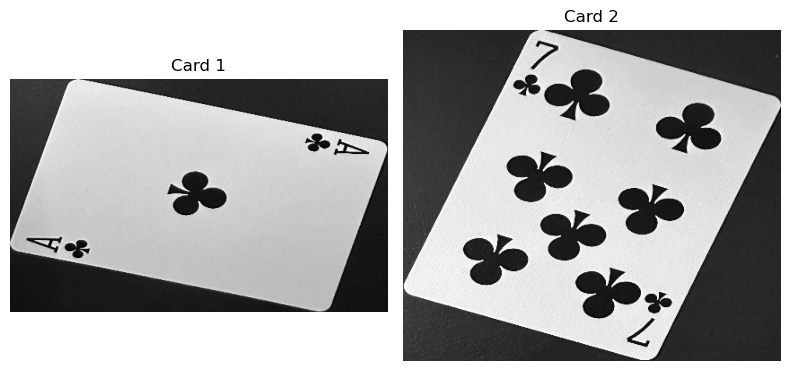

Image 66: Contours after area filtering: 3
Image 66: Final contours: 3


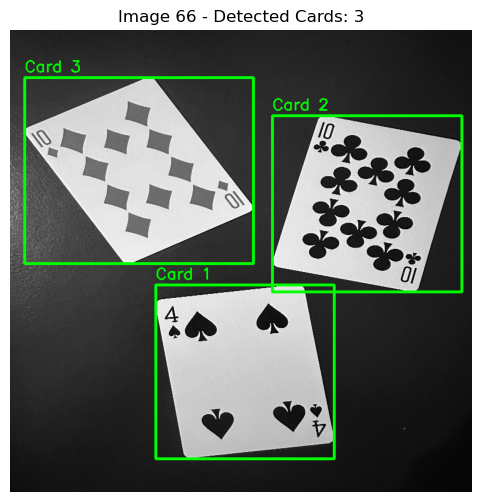

Saved output_cards/nate_image66_card_1.jpg
Saved output_cards/nate_image66_card_2.jpg
Saved output_cards/nate_image66_card_3.jpg


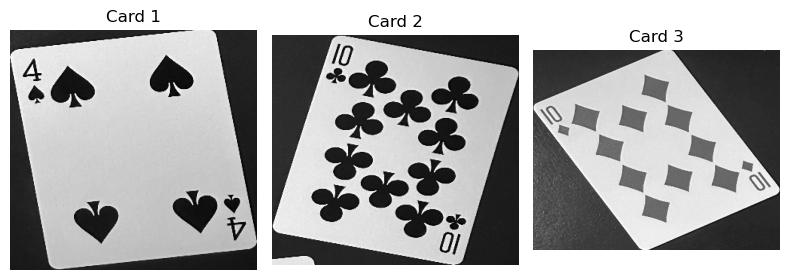

Image 67: Contours after area filtering: 2
Image 67: Final contours: 2


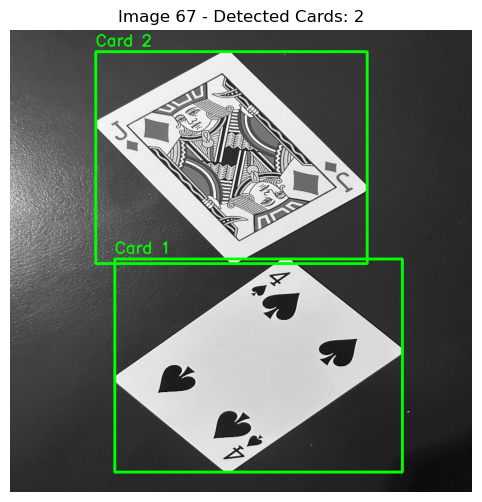

Saved output_cards/nate_image67_card_1.jpg
Saved output_cards/nate_image67_card_2.jpg


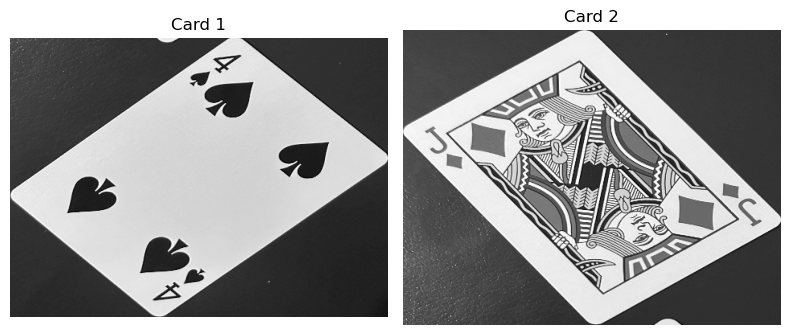

Image 68: Contours after area filtering: 1
Image 68: Final contours: 1


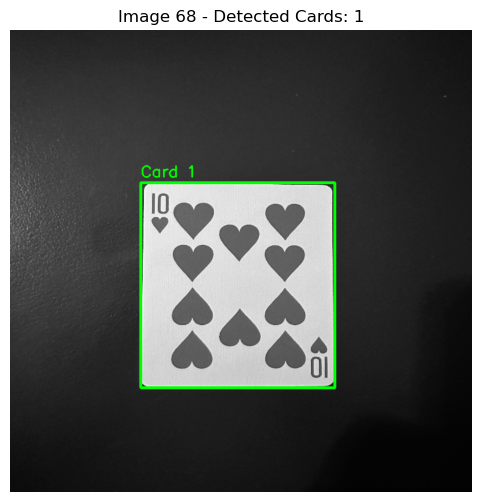

Saved output_cards/nate_image68_card_1.jpg


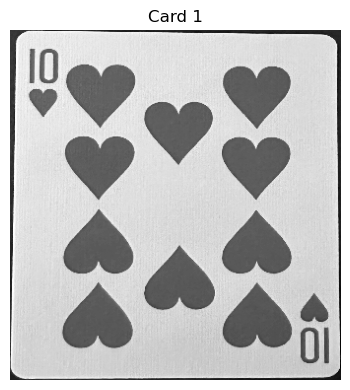

Image 69: Contours after area filtering: 3
Image 69: Final contours: 3


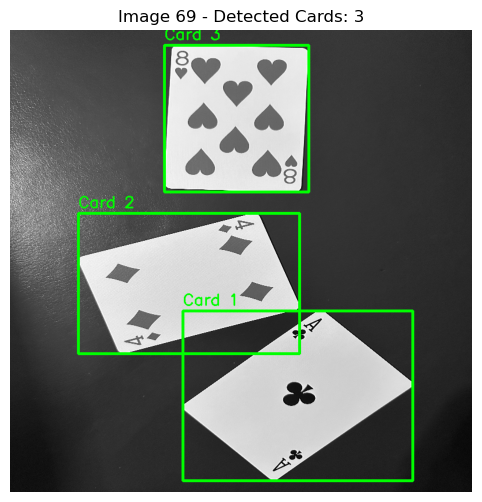

Saved output_cards/nate_image69_card_1.jpg
Saved output_cards/nate_image69_card_2.jpg
Saved output_cards/nate_image69_card_3.jpg


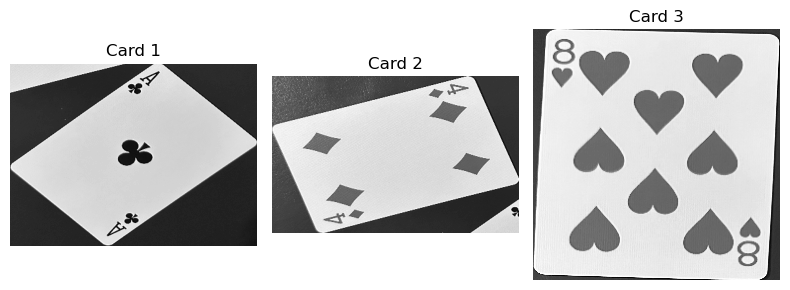

Image 70: Contours after area filtering: 1
Image 70: Final contours: 1


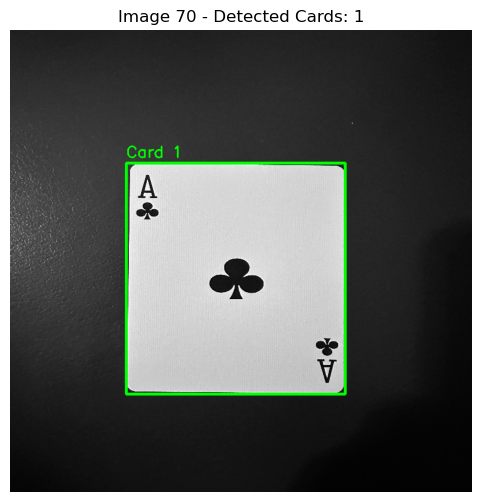

Saved output_cards/nate_image70_card_1.jpg


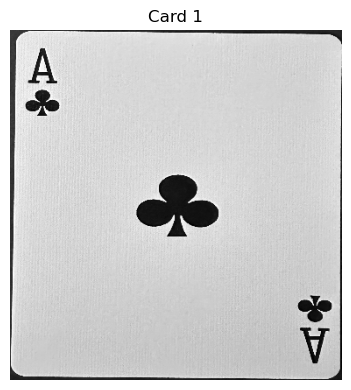

Image 71: Contours after area filtering: 1
Image 71: Final contours: 1


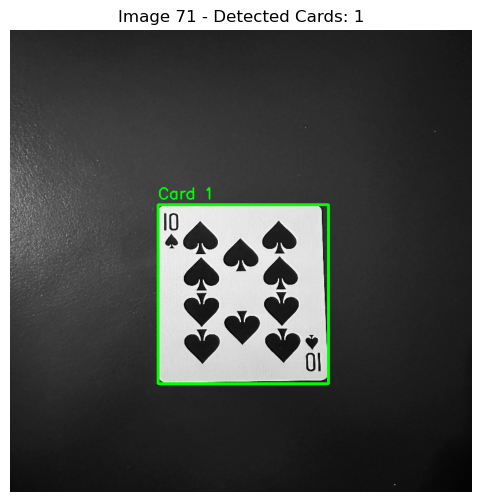

Saved output_cards/nate_image71_card_1.jpg


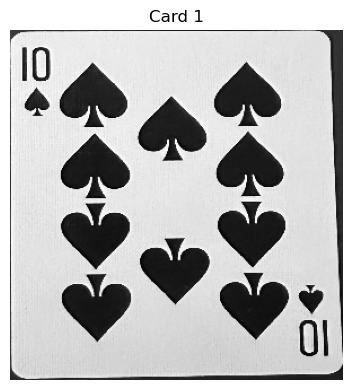

Image 72: Contours after area filtering: 1
Image 72: Final contours: 1


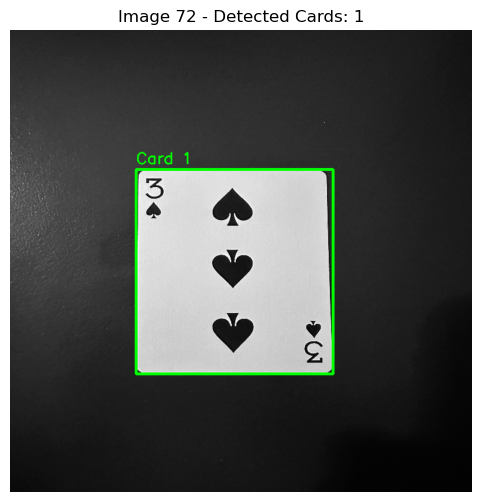

Saved output_cards/nate_image72_card_1.jpg


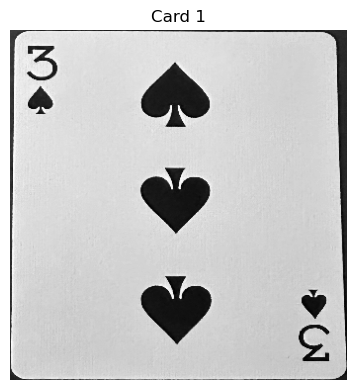

Image 73: Contours after area filtering: 2
Image 73: Final contours: 2


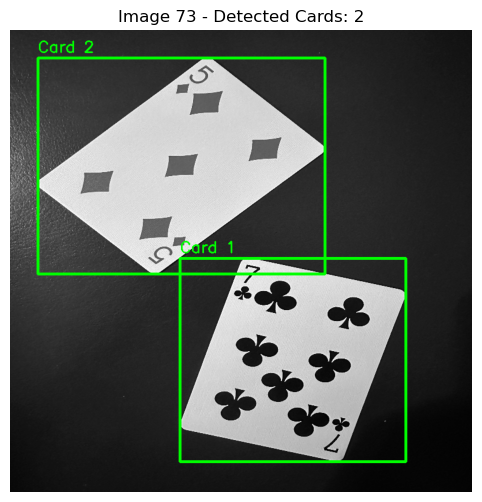

Saved output_cards/nate_image73_card_1.jpg
Saved output_cards/nate_image73_card_2.jpg


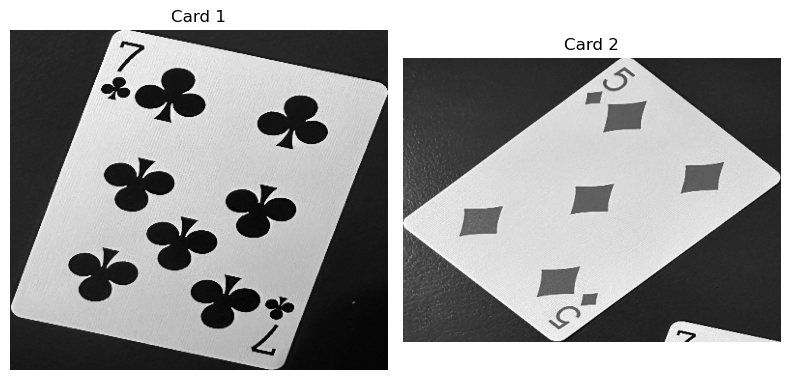

Image 74: Contours after area filtering: 1
Image 74: Final contours: 1


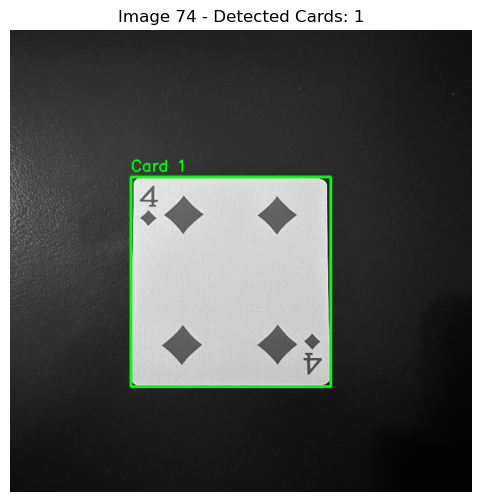

Saved output_cards/nate_image74_card_1.jpg


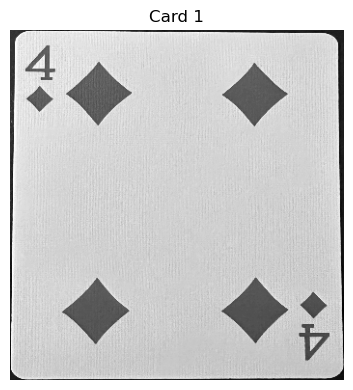

Image 75: Contours after area filtering: 1
Image 75: Final contours: 1


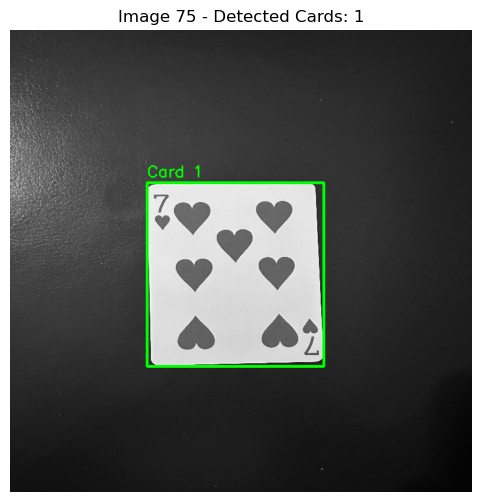

Saved output_cards/nate_image75_card_1.jpg


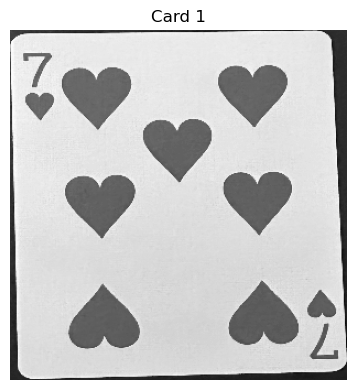

Image 76: Contours after area filtering: 1
Image 76: Final contours: 1


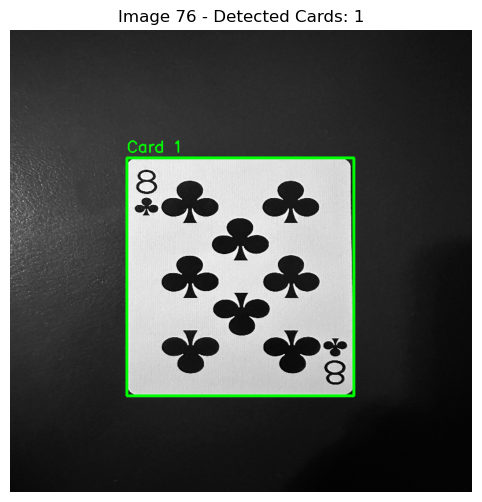

Saved output_cards/nate_image76_card_1.jpg


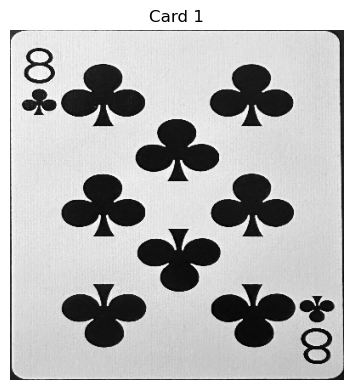

Image 77: Contours after area filtering: 1
Image 77: Final contours: 1


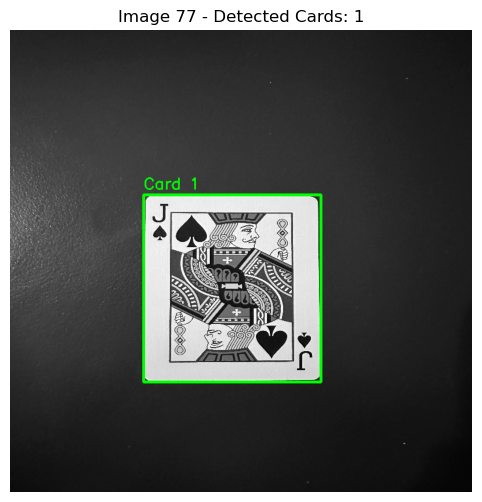

Saved output_cards/nate_image77_card_1.jpg


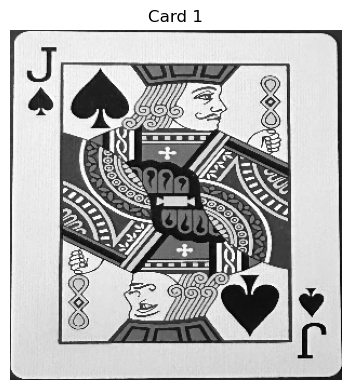

Image 78: Contours after area filtering: 1
Image 78: Final contours: 1


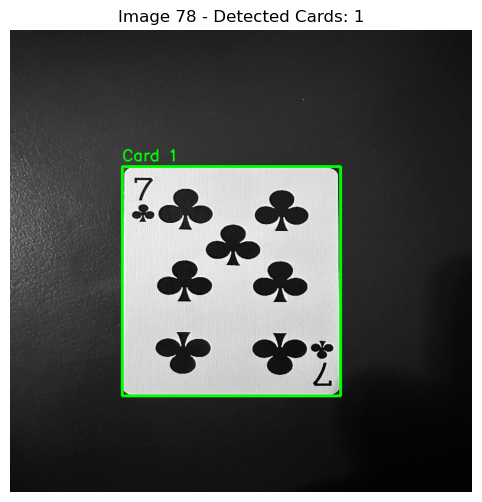

Saved output_cards/nate_image78_card_1.jpg


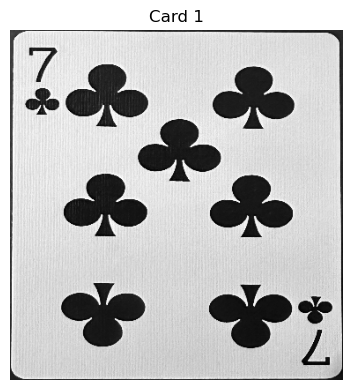

Image 79: Contours after area filtering: 2
Image 79: Final contours: 2


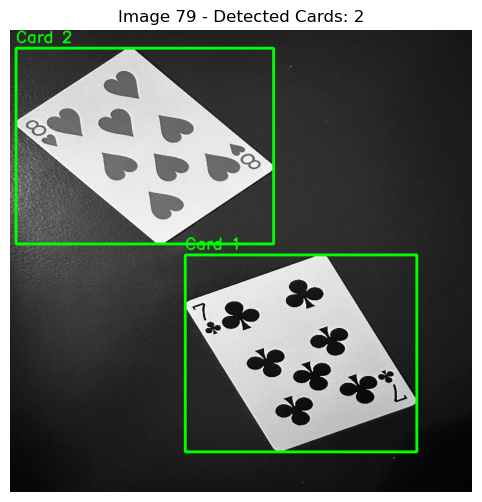

Saved output_cards/nate_image79_card_1.jpg
Saved output_cards/nate_image79_card_2.jpg


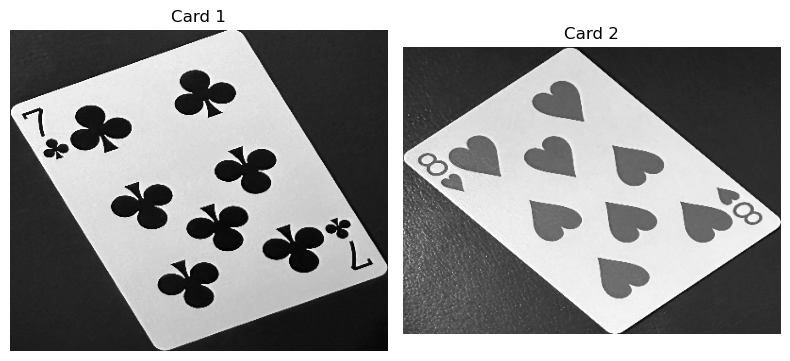

Image 80: Contours after area filtering: 1
Image 80: Final contours: 1


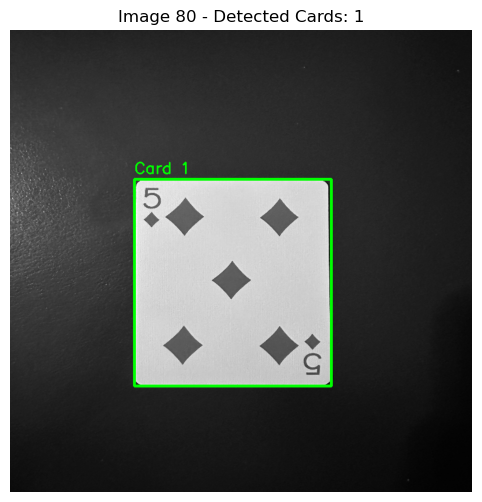

Saved output_cards/nate_image80_card_1.jpg


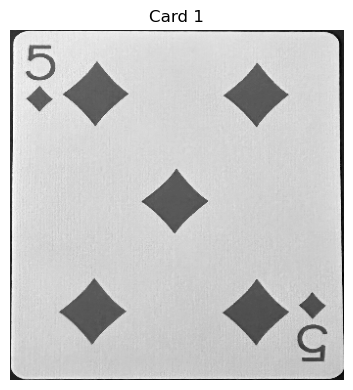

In [17]:
output_folder = "output_cards"
os.makedirs(output_folder, exist_ok=True)

# Loop through each grayscale image
for idx, gray in enumerate(gray_imgs):
    # Compute the Canny edge detection result for this image
    canny_result = canny(gray)
    canny_result_uint8 = (canny_result * 255).astype(np.uint8)
    contours, hierarchy = cv2.findContours(canny_result_uint8, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filter contours by area first
    filtered_contours = []
    for contour in contours:
        area = cv2.contourArea(contour)
        if 10000 < area < 300000:
            filtered_contours.append(contour)
    print(f"Image {idx+1}: Contours after area filtering: {len(filtered_contours)}")

    # Just keep the first contour if they're duplicates (comparing only the first two)
    if len(filtered_contours) > 1:
        boxes = [cv2.boundingRect(c) for c in filtered_contours]
        x1, y1, w1, h1 = boxes[0]
        x2, y2, w2, h2 = boxes[1]
        if x1 == x2 and y1 == y2 and w1 == w2 and h1 == h2:
            print("Found duplicate contours with identical coordinates - keeping only one")
            final_contours = [filtered_contours[0]]
        else:
            final_contours = filtered_contours
    else:
        final_contours = filtered_contours

    print(f"Image {idx+1}: Final contours: {len(final_contours)}")

    # Create a color image for visualization of this gray image
    result_img = cv2.cvtColor(gray.copy(), cv2.COLOR_GRAY2BGR)

    # Process each final contour to extract card images
    card_images = []
    for i, contour in enumerate(final_contours):
        x, y, w, h = cv2.boundingRect(contour)
        card = gray[y:y+h, x:x+w]
        card_images.append(card)
        
        # Draw green rectangle and label on the result image
        cv2.rectangle(result_img, (x, y), (x+w, y+h), (0, 255, 0), 3)
        cv2.putText(result_img, f"Card {i+1}", (x, y-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)

    # Visualize the detection results for the current image
    plt.figure(figsize=(10, 6))
    plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
    plt.title(f"Image {idx+1} - Detected Cards: {len(card_images)}")
    plt.axis('off')
    plt.show()

    # Save each extracted card image with unique filenames
    for i, card in enumerate(card_images):
        output_path = os.path.join(output_folder, f"nate_image{idx+1}_card_{i+1}.jpg")
        success = cv2.imwrite(output_path, card)
        if success:
            print(f"Saved {output_path}")
        else:
            print(f"Failed to save {output_path}")

    # Optionally, display the extracted card images for the current image
    if card_images:
        plt.figure(figsize=(8, 4))
        for i, card in enumerate(card_images):
            plt.subplot(1, len(card_images), i+1)
            plt.imshow(card, cmap='gray')
            plt.title(f"Card {i+1}")
            plt.axis('off')
        plt.tight_layout()
        plt.show()